In [1]:
import mne
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mne.preprocessing import ICA


In [2]:
data_path = 'data.edf'
print("1. Importing raw data...")
raw = mne.io.read_raw_edf(data_path, preload=True, verbose=False)


1. Importing raw data...


C:\Users\suryansh\AppData\Local\Temp\ipykernel_13704\1223725095.py:3: RuntimeWarning: Channels contain different highpass filters. Highest filter setting will be stored.
  raw = mne.io.read_raw_edf(data_path, preload=True, verbose=False)


In [3]:
raw

<RawEDF | data.edf, 35 x 660000 (1320.0 s), ~176.3 MiB, data loaded>

In [4]:
raw.drop_channels(['X','Y','Z'])  # Drop unnecessary channels if they exist

<RawEDF | data.edf, 32 x 660000 (1320.0 s), ~161.2 MiB, data loaded>

In [5]:

# --- 2. Channel and Montage Configuration ---
print("\n2. Configuring channels and montage...")

raw.set_channel_types({ch_name: 'eeg' for ch_name in raw.ch_names if 'EEG' in ch_name}) 

# Set the standard 10-10 montage
montage = mne.channels.make_standard_montage('standard_1020')
raw.set_montage(montage, on_missing='ignore') # 'ignore' if some electrodes in data are not in 10-10, or 'warn'

# Drop channels that are not EEG or not in the montage, if any
# This is a common step if your data has auxiliary channels
raw.pick_types(eeg=True, meg=False, stim=True, exclude='bads') # Keep EEG and stim channels



2. Configuring channels and montage...
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


<RawEDF | data.edf, 32 x 660000 (1320.0 s), ~161.2 MiB, data loaded>

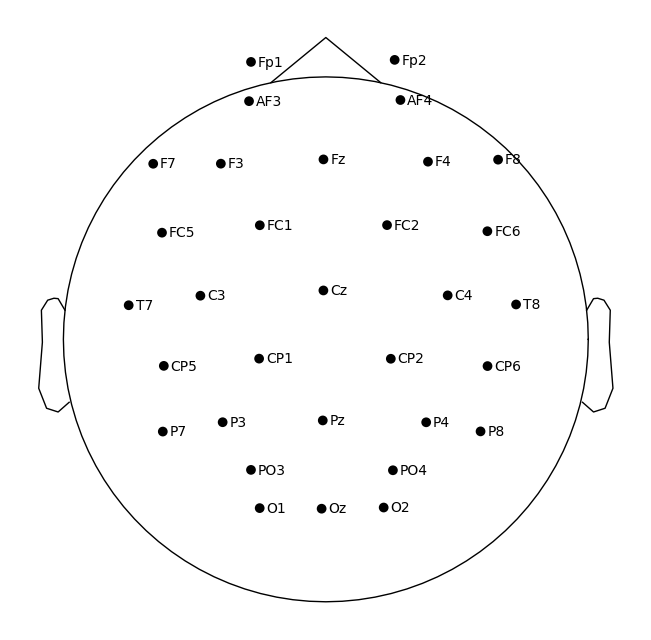

In [6]:
raw.set_channel_types({ch: 'eeg' for ch in raw.ch_names if 'EEG' in ch})
    
    # Plot sensor locations
raw.plot_sensors(show_names=True, title='10-10 Electrode Placement');


In [7]:
print(f"Channels after picking: {raw.ch_names}")
raw.info['bads'] = [] # Clear bads if any were marked during import
print(f"Montage applied. Number of EEG channels: {len(raw.info['ch_names'])}")

Channels after picking: ['P8', 'T8', 'CP6', 'FC6', 'F8', 'F4', 'C4', 'P4', 'AF4', 'Fp2', 'Fp1', 'AF3', 'Fz', 'FC2', 'Cz', 'CP2', 'PO3', 'O1', 'Oz', 'O2', 'PO4', 'Pz', 'CP1', 'FC1', 'P3', 'C3', 'F3', 'F7', 'FC5', 'CP5', 'T7', 'P7']
Montage applied. Number of EEG channels: 32


In [8]:
# --- 3. Filtering ---

print("\n3. Applying filters...")
# Create a copy for PSD analysis as ERP filtering is stricter
raw_for_psd = raw.copy()



# ERP Filtering: 0.1-30 Hz band-pass
raw.filter(l_freq=0.1, h_freq=30, fir_design='firwin', verbose=False)
print(f"Band-pass filter (ERP): {0.1}-{30} Hz applied.")




3. Applying filters...
Band-pass filter (ERP): 0.1-30 Hz applied.


In [9]:
# PSD Filtering: 1-45 Hz band-pass
raw_for_psd.filter(l_freq=1, h_freq=45, fir_design='firwin', verbose=False)
print(f"Band-pass filter (PSD): {1}-{45} Hz applied.")



Band-pass filter (PSD): 1-45 Hz applied.


In [10]:
# Notch filter for both
raw.notch_filter(freqs=50, fir_design='firwin', verbose=False)
raw_for_psd.notch_filter(freqs=50, fir_design='firwin', verbose=False)
print(f"Notch filter: {50} Hz applied.")

Notch filter: 50 Hz applied.


In [11]:

# --- 4. Downsampling ---

raw.resample(sfreq=250, verbose=False)
raw_for_psd.resample(sfreq=250, verbose=False)
print(f"Data resampled to {raw.info['sfreq']} Hz.")


Data resampled to 250.0 Hz.


In [12]:
# --- 5. Re-referencing ---
print("\n5. Applying common average reference...")
raw.set_eeg_reference('average', projection=True, verbose=False) # projection=True for ICA compatibility
raw_for_psd.set_eeg_reference('average', projection=True, verbose=False)
print("Common average reference applied.")


5. Applying common average reference...
Common average reference applied.


In [13]:
# --- 6. Artifact Correction (ICA) ---
# Apply ICA on a filtered copy (high-pass filter recommended for ICA)
ica_raw = raw.copy().filter(l_freq=1.0, h_freq=None, fir_design='firwin', verbose=False) # High-pass for ICA stability
ica = mne.preprocessing.ICA(n_components=32, random_state=99,method='fastica') # n_components=0.95 means retain 95% variance
ica.fit(ica_raw)

Fitting ICA to data using 32 channels (please be patient, this may take a while)
Selecting by number: 32 components
Fitting ICA took 14.2s.


Method,fastica
Fit parameters,algorithm=parallelfun=logcoshfun_args=Nonemax_iter=1000
Fit,70 iterations on raw data (330000 samples)
ICA components,32
Available PCA components,32
Channel types,eeg
ICA components marked for exclusion,—


In [14]:
# 6.2 Automatic rejection using peak-to-peak amplitude
reject = dict(eeg=150e-6)

Creating RawArray with float64 data, n_channels=32, n_times=330000
    Range : 0 ... 329999 =      0.000 ...  1319.996 secs
Ready.
Using matplotlib as 2D backend.


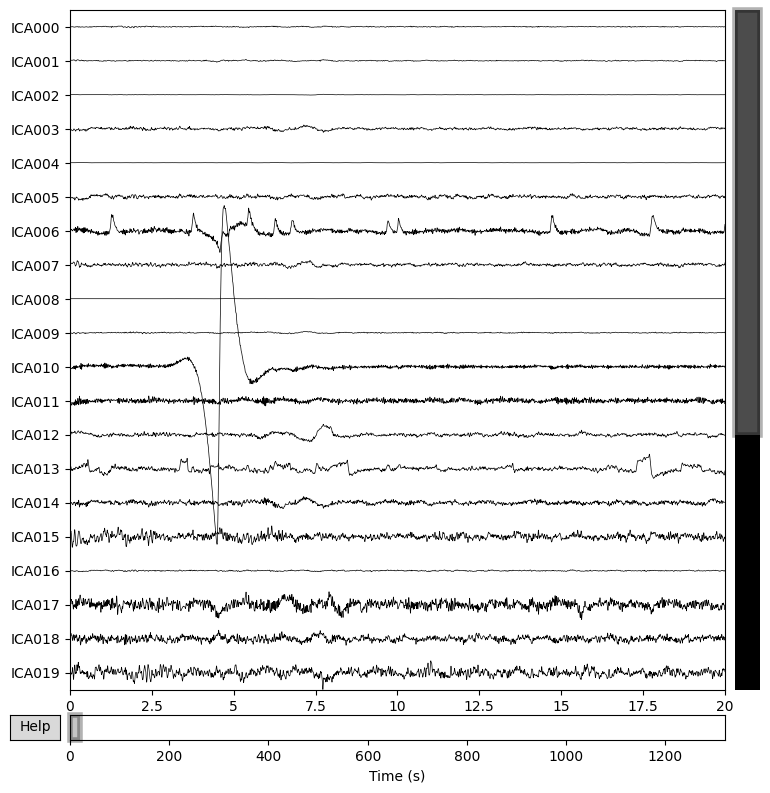

In [15]:
ica.plot_sources(ica_raw) ;

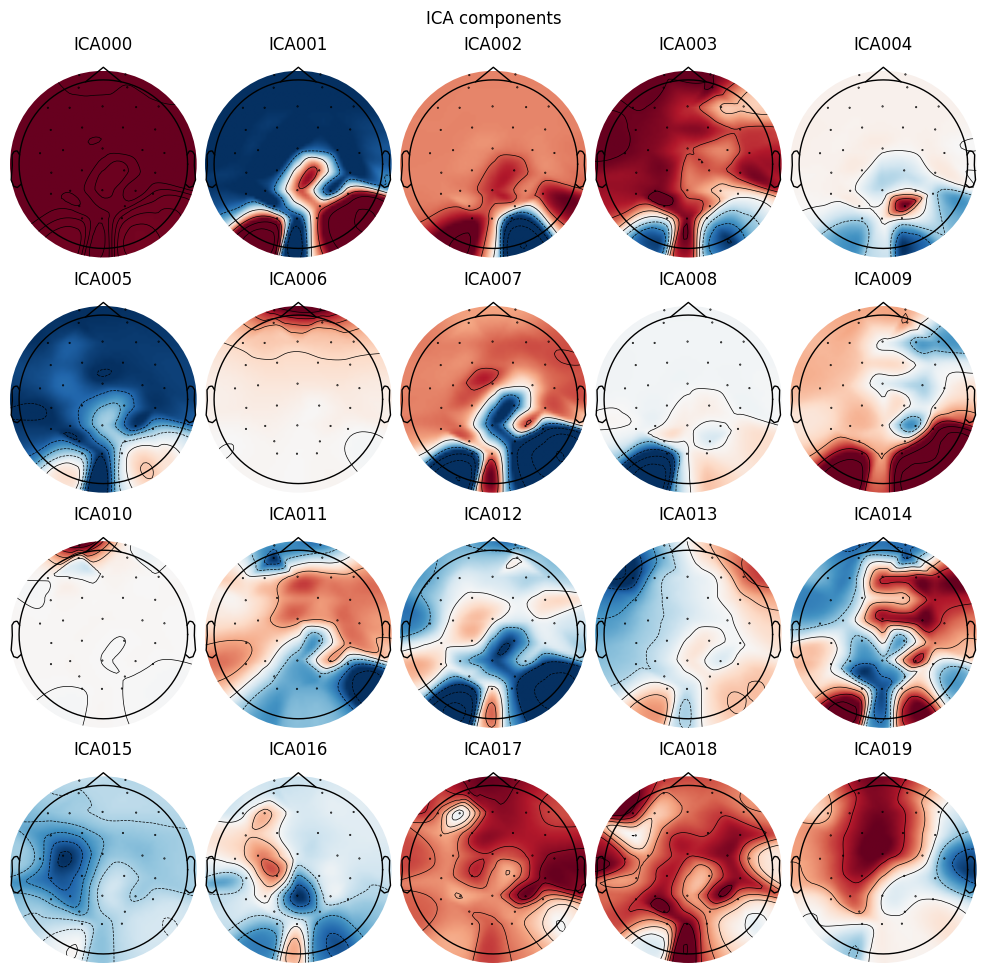

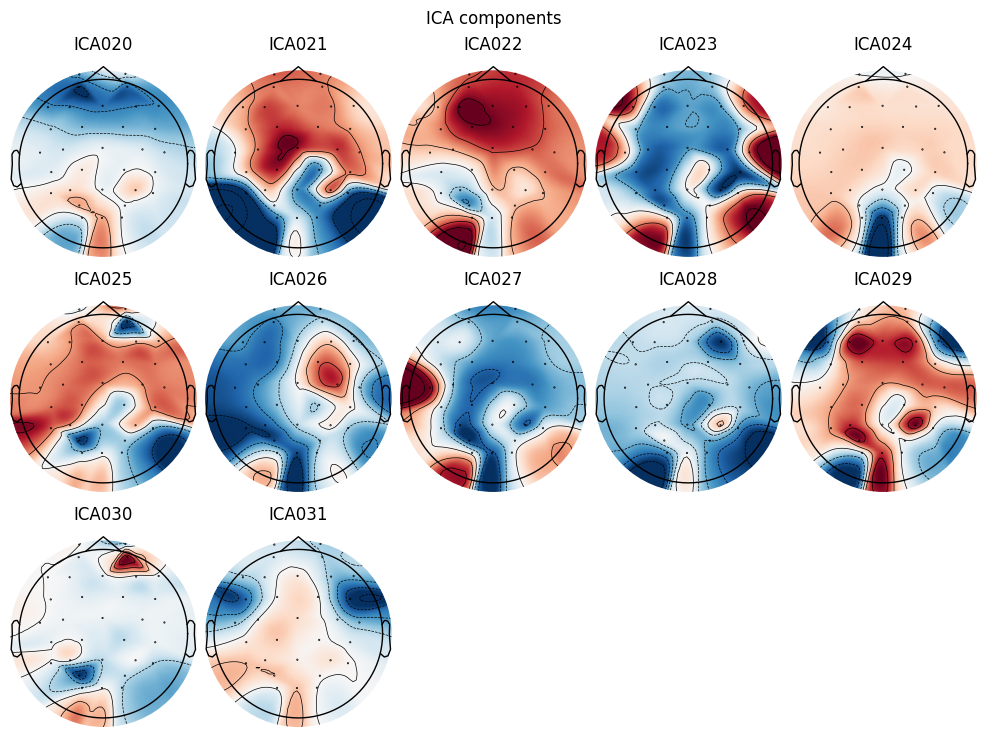

In [16]:
ica.plot_components() ;

In [17]:
# Apply ICA unmixing matrix to the original (pre-ICA) raw data
print(f"Applying ICA solution. Original signal might need to be restored if projection was used earlier.")
ica.apply(raw, verbose=False)
ica.apply(raw_for_psd, verbose=False) # Apply to PSD data as well
print("ICA artifact correction applied.")

Applying ICA solution. Original signal might need to be restored if projection was used earlier.
ICA artifact correction applied.


In [20]:
def parse_easy_file(easy_file_path):
    """Parse the easy file containing events and timestamps"""
    # Read the easy file (space/tab separated values)
    data = np.loadtxt(easy_file_path)
    
    # Last column is timestamp in milliseconds
    timestamps = data[:, -1]
    
    # Create events array: [sample_idx, 0, event_code]
    events = []
    sfreq = raw.info['sfreq']
    first_timestamp = timestamps[0]
    
    for i, ts in enumerate(timestamps):
        # Calculate sample index from timestamp
        time_diff = (ts - first_timestamp) / 1000.0  # Convert to seconds
        sample_idx = int(time_diff * sfreq)
        
        # Create event - use a unique code for each timestamp
        events.append([sample_idx, 0, i+1])
    
    return np.array(events), timestamps

# Load events from easy file
events, timestamps = parse_easy_file('sample.easy')

# 8. Create event dictionary based on your experiment markers
event_dict = {
    'BINARY_TASK_START': 1,
    'CHOICE_A': 2,
    'CHOICE_B': 3,
    'CHOICE_R': 4,
    'TRIVIA_START': 5,
    'CHOICE_B_WIN': 6,
    'CHOICE_B_LOSS': 7
}

# 9. Epoching configuration
epochs_dict = {
    'P300': {
        'events': ['CHOICE_A', 'CHOICE_B', 'CHOICE_R'],
        'tmin': -0.2,
        'tmax': 0.8,
        'baseline': (-0.2, 0),
        'channels': ['Pz', 'CPz', 'Cz', 'P3', 'P4', 'Fz', 'Oz', 'CP3', 'CP4']
    },
    'N200': {
        'events': ['TRIVIA_START'],
        'tmin': -0.2,
        'tmax': 0.5,
        'baseline': (-0.2, 0),
        'channels': ['FCz', 'Fz', 'Cz', 'FC3', 'FC4']
    },
    'FRN': {
        'events': ['CHOICE_B_WIN', 'CHOICE_B_LOSS', 'CHOICE_A'],
        'tmin': -0.2,
        'tmax': 0.6,
        'baseline': (-0.2, 0),
        'channels': ['FCz', 'Cz', 'CPz']
    }
}

# 10. Create epochs
all_epochs = {}
for name, params in epochs_dict.items():
    # Get event IDs for this component
    event_ids = {e: event_dict[e] for e in params['events'] if e in event_dict}
    
    if not event_ids:
        print(f"No events found for {name}. Skipping...")
        continue
    
    # Create epochs
    epochs = mne.Epochs(
        raw,
        events,
        event_id=event_ids,
        tmin=params['tmin'],
        tmax=params['tmax'],
        baseline=params['baseline'],
        picks=params['channels'],
        preload=True,
        event_repeated='drop'
    )
    
    # Apply rejection
    reject_criteria = dict(eeg=150e-6)  # 150 µV peak-to-peak
    epochs.drop_bad(reject=reject_criteria)
    
    all_epochs[name] = epochs
    print(f"Created {len(epochs)} epochs for {name}")

Multiple event values for single event times found. Keeping the first occurrence and dropping all others.
Not setting metadata
2 matching events found


ValueError: Channel(s) [np.str_('CPz'), np.str_('CP3'), np.str_('CP4')] could not be picked, because they are not present in the info instance.

In [ ]:
events, event_dict = mne.events_from_annotations(raw)

# Define epoch parameters
epochs_params = {
    'P300': {
        'event_id': {'CHOICE_A': 1, 'CHOICE_B': 2, 'CHOICE_R': 3},
        'tmin': -0.2,
        'tmax': 0.8,
        'baseline': (-0.2, 0),
        'channels': ['Pz', 'CPz', 'Cz', 'P3', 'P4', 'Fz', 'Oz', 'CP3', 'CP4']
    },
    'N200': {
        'event_id': {'TRIVIA_START': 4},
        'tmin': -0.2,
        'tmax': 0.5,
        'baseline': (-0.2, 0),
        'channels': ['FCz', 'Fz', 'Cz', 'FC3', 'FC4']
    },
    'FRN': {
        'event_id': {'CHOICE_B_WIN': 5, 'CHOICE_B_LOSS': 6, 'CHOICE_A': 7},
        'tmin': -0.2,
        'tmax': 0.6,
        'baseline': (-0.2, 0),
        'channels': ['FCz', 'Cz', 'CPz']
    }
}


# Create epochs for each component
all_epochs = {}

for comp, params in epochs_params.items():
    # Create epochs
    epochs = mne.Epochs(
        raw,
        events,
        event_id=params['event_id'],
        tmin=params['tmin'],
        tmax=params['tmax'],
        baseline=params['baseline'],
        picks=params['channels'],
        preload=True,
        event_repeated='drop'
    )
    
    # Add rejection (adjust thresholds based on your data)
    reject_criteria = dict(eeg=150e-6)  # 150 µV peak-to-peak
    epochs.drop_bad(reject=reject_criteria)
    
    all_epochs[comp] = epochs
    print(f"Created {len(epochs)} epochs for {comp}")

ValueError: No matching events found for CHOICE_A (event id 1)

In [ ]:
events, event_dict = mne.events_from_annotations(raw)
print(event_dict)
print(events[:10])  # or full if small


{}
[]


In [ ]:
print(event_dict)  # Show all detected markers

{}


In [7]:
import csv

# Input and output file paths
input_file = '20250618170033_test_marker_update_9_EEG MAIN STUDY (1).easy'   # Replace with your input file path
output_file = '20250618170033_test_marker_update_9_EEG MAIN STUDY (1).csv' # Replace with your output file path

with open(input_file, 'r') as infile, open(output_file, 'w', newline='') as outfile:
    writer = csv.writer(outfile)
    
    for line in infile:
        # Split the line into fields using tab as the delimiter
        fields = line.strip().split('\t')
        
        # Extract the second-to-last field if available
        if len(fields) >= 2:
            column_value = fields[-2]  # Second-to-last field
        else:
            column_value = ''
        
        # Write the value to the CSV
        writer.writerow([column_value])

print(f"CSV file '{output_file}' has been created with the extracted column.")

CSV file '20250618170033_test_marker_update_9_EEG MAIN STUDY (1).csv' has been created with the extracted column.


In [23]:
import mne
import numpy as np
import pandas as pd
from mne.preprocessing import ICA
import matplotlib.pyplot as plt
from datetime import datetime

def parse_easy_file(easy_file_path, sfreq, start_time):
    """
    Parse .easy file containing EEG data and events.
    
    Parameters:
    easy_file_path: Path to .easy file
    sfreq: Sampling frequency of EEG data
    start_time: Recording start time from EDF header
    
    Returns:
    events: MNE-compatible events array
    event_dict: Dictionary mapping event names to event codes
    """
    # Read .easy file (space-separated values)
    data = pd.read_csv(easy_file_path, sep='\s+', header=None)
    
    # Extract timestamps (last column)
    timestamps = data.iloc[:, -1].values
    
    # Calculate time differences in milliseconds
    time_diffs = timestamps - timestamps[0]
    
    # Convert to seconds
    time_sec = time_diffs / 1000.0
    
    # Convert to sample indices
    sample_indices = (time_sec * sfreq).astype(int)
    
    # Create events array
    events = []
    event_dict = {}
    next_event_id = 1
    
    # Check for event markers in the data
    # Assuming events are in columns 32-35 (0-indexed indices 32, 33, 34, 35)
    for i in range(len(data)):
        # Check if any event marker is non-zero
        for col_idx in [32, 33, 34, 35]:
            marker_value = data.iloc[i, col_idx]
            if marker_value != 0:
                # Create event name based on column index and value
                event_name = f"COL{col_idx}_VAL{marker_value}"
                
                if event_name not in event_dict:
                    event_dict[event_name] = next_event_id
                    next_event_id += 1
                
                events.append([sample_indices[i], 0, event_dict[event_name]])
    
    return np.array(events), event_dict

# 1. Load raw EDF file
raw = mne.io.read_raw_edf('data.edf', preload=True)
raw.drop_channels(['X','Y','Z'])  # Drop unnecessary channels if they exist

# Get recording start time and sampling frequency
sfreq = raw.info['sfreq']
start_time = raw.info['meas_date']

# 2. Set montage (10-10 system)
montage = mne.channels.make_standard_montage('standard_1020')
raw.set_montage(montage)

# 3. Filtering
raw_erp = raw.copy().filter(0.1, 30, fir_design='firwin')
raw_erp.notch_filter(50)

# 4. Downsampling (optional)
if raw.info['sfreq'] > 250:
    raw_erp.resample(250)
    sfreq = 250  # Update sampling frequency after resampling

# 5. Re-referencing
raw_erp.set_eeg_reference('average')

# 6. Artifact Correction
ica = ICA(n_components=15, random_state=97)
ica.fit(raw_erp)

# Find and remove blink artifacts
eog_indices, eog_scores = ica.find_bads_eog(raw_erp, ch_name=['Fp1', 'Fpz', 'Fp2'])
if eog_indices:
    ica.exclude = eog_indices[:1]  # Exclude strongest blink component
raw_erp_clean = ica.apply(raw_erp.copy())

# 7. Read events from .easy file
events, event_dict = parse_easy_file('sample.easy', sfreq, start_time)

# Print detected events for verification
print("Detected events:")
for event_name, event_id in event_dict.items():
    print(f"{event_name}: {event_id}")

# 8. Manually map detected events to experiment markers
# You'll need to customize this based on your experiment design
custom_event_dict = {
    'BINARY_TASK_START': 1,
    'CHOICE_A': 2,
    'CHOICE_B': 3,
    'CHOICE_R': 4,
    'TRIVIA_START': 5,
    'CHOICE_B_WIN': 6,
    'CHOICE_B_LOSS': 7
}

# Create a mapping from detected event IDs to custom names
# This requires your manual input based on experiment design
event_mapping = {
    # Example mapping - you MUST customize this:
    # 'COL32_VAL951': 'BINARY_TASK_START',
    # 'COL33_VAL-9139': 'CHOICE_A',
    # Add your actual mappings here
}

# Create new events array with custom event IDs
mapped_events = []
for event in events:
    detected_id = event[2]
    for detected_name, detected_id_val in event_dict.items():
        if detected_id_val == detected_id:
            if detected_name in event_mapping:
                custom_name = event_mapping[detected_name]
                if custom_name in custom_event_dict:
                    new_id = custom_event_dict[custom_name]
                    mapped_events.append([event[0], event[1], new_id])

mapped_events = np.array(mapped_events)

# 9. Epoching configuration
epochs_dict = {
    'P300': {
        'events': ['CHOICE_A', 'CHOICE_B', 'CHOICE_R'],
        'tmin': -0.2,
        'tmax': 0.8,
        'baseline': (-0.2, 0),
        'channels': ['Pz', 'CPz', 'Cz', 'P3', 'P4', 'Fz', 'Oz', 'CP3', 'CP4']
    },
    'N200': {
        'events': ['TRIVIA_START'],
        'tmin': -0.2,
        'tmax': 0.5,
        'baseline': (-0.2, 0),
        'channels': ['FCz', 'Fz', 'Cz', 'FC3', 'FC4']
    },
    'FRN': {
        'events': ['CHOICE_B_WIN', 'CHOICE_B_LOSS', 'CHOICE_A'],
        'tmin': -0.2,
        'tmax': 0.6,
        'baseline': (-0.2, 0),
        'channels': ['FCz', 'Cz', 'CPz']
    }
}

# 10. Create epochs
all_epochs = {}
for name, params in epochs_dict.items():
    # Get event IDs for this component
    event_ids = {e: custom_event_dict[e] for e in params['events'] 
                if e in custom_event_dict}
    
    if not event_ids:
        print(f"No events found for {name}. Skipping...")
        continue
    
    # Create epochs
    epochs = mne.Epochs(
        raw_erp_clean,
        mapped_events,
        event_id=event_ids,
        tmin=params['tmin'],
        tmax=params['tmax'],
        baseline=params['baseline'],
        picks=params['channels'],
        preload=True,
        event_repeated='drop'
    )
    
    # Apply rejection
    reject_criteria = dict(eeg=150e-6)  # 150 µV peak-to-peak
    epochs.drop_bad(reject=reject_criteria)
    
    all_epochs[name] = epochs
    print(f"Created {len(epochs)} epochs for {name}")

# 11. PSD Analysis
freq_bands = {
    'Theta': (4, 7),
    'Alpha': (8, 12),
    'Beta': (13, 30)
}

# Compute PSD for each epoch type
psd_results = {}
for name, epochs in all_epochs.items():
    # Compute PSD using Welch method
    psds, freqs = mne.time_frequency.psd_welch(
        epochs,
        fmin=1,
        fmax=45,
        n_fft=256,
        n_overlap=128,
        average='mean'
    )
    
    # Calculate band power
    band_power = {}
    for band, (fmin, fmax) in freq_bands.items():
        band_idx = np.logical_and(freqs >= fmin, freqs <= fmax)
        band_power[band] = np.mean(psds[:, :, band_idx], axis=-1)
    
    psd_results[name] = band_power

# 12. Topographic Maps
# ERP component topomaps
erp_times = {
    'P300': [0.3, 0.4, 0.5],    # P300 peak times
    'N200': [0.25, 0.3, 0.35],   # N200 peak times
    'FRN': [0.25, 0.3, 0.35]     # FRN peak times
}

for name, epochs in all_epochs.items():
    evoked = epochs.average()
    fig = evoked.plot_topomap(
        times=erp_times[name],
        ch_type='eeg',
        time_unit='ms',
        size=3,
        title=f'{name} Topography'
    )
    fig.savefig(f'{name}_topomap.png', dpi=300)

# PSD band power topomaps
for name, band_power in psd_results.items():
    for band, power in band_power.items():
        # Create fake Evoked object for topography
        info = all_epochs[name].info.copy()
        fake_evoked = mne.EvokedArray(
            np.mean(power, axis=0)[:, np.newaxis],
            info,
            tmin=0
        )
        
        # Plot topomap
        fig = fake_evoked.plot_topomap(
            times=[0],
            ch_type='eeg',
            size=3,
            title=f'{name} {band} Power',
            show=False
        )
        fig.suptitle(f'{name} {band} Band Power')
        fig.savefig(f'{name}_{band}_power_topomap.png', dpi=300)

# 13. Save results
for name, epochs in all_epochs.items():
    epochs.save(f'{name}_epo.fif', overwrite=True)

# Save PSD results
np.savez('psd_results.npz', **psd_results)

# Visualize events on EEG trace for verification
raw_erp_clean.plot(events=mapped_events, event_id=custom_event_dict, block=True)

Extracting EDF parameters from c:\pc\iitmandi\EEG\data.edf...
EDF file detected
Setting channel info structure...


Creating raw.info structure...
Reading 0 ... 659999  =      0.000 ...  1319.998 secs...


C:\Users\suryansh\AppData\Local\Temp\ipykernel_13704\4184752134.py:60: RuntimeWarning: Channels contain different highpass filters. Highest filter setting will be stored.
  raw = mne.io.read_raw_edf('data.edf', preload=True)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 16501 samples (33.002 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.2s


Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 3301 samples (6.602 s)



[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    0.5s finished
[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    0.3s finished


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 32 channels (please be patient, this may take a while)
Selecting by number: 15 components
Fitting ICA took 4.4s.


ValueError: The specified EOG channel cannot be found: Fpz

In [1]:
import numpy as np

# load the .easy file
data = np.loadtxt('sample.easy')

# eeg_data will be shape (n_samples, 32)
eeg_data    = data[:, :32]

# trigger channel is column 32 (0‑indexed)
triggers    = data[:, 32]

# timestamps are in the last column
timestamps  = data[:, -1]

# find where an event occurs (non‑zero trigger)
event_idx   = np.where(triggers != 0)[0]
event_codes = triggers[event_idx]
event_times = timestamps[event_idx]

for idx, code, time in zip(event_idx, event_codes, event_times):
    print(f"Event {code} at sample row {idx}, time {time}")


Event 411.0 at sample row 19, time 1750248518659.0
Event 411.0 at sample row 20, time 1750248518661.0
Event 411.0 at sample row 21, time 1750248518663.0
Event 411.0 at sample row 22, time 1750248518665.0
Event 411.0 at sample row 23, time 1750248518667.0
Event 304.0 at sample row 24, time 1750248518669.0
Event 304.0 at sample row 25, time 1750248518671.0
Event 304.0 at sample row 26, time 1750248518673.0
Event 304.0 at sample row 27, time 1750248518675.0
Event 304.0 at sample row 28, time 1750248518677.0
Event 382.0 at sample row 29, time 1750248518679.0
Event 382.0 at sample row 30, time 1750248518681.0
Event 382.0 at sample row 31, time 1750248518683.0
Event 382.0 at sample row 32, time 1750248518685.0
Event 382.0 at sample row 33, time 1750248518687.0
Event 264.0 at sample row 34, time 1750248518689.0
Event 264.0 at sample row 35, time 1750248518691.0
Event 264.0 at sample row 36, time 1750248518693.0
Event 264.0 at sample row 37, time 1750248518695.0
Event 264.0 at sample row 38, t

In [2]:
import os
import mne
import numpy as np
import pandas as pd

# ---------------------------
# 1. Raw Data Import
# ---------------------------

def load_raw_edf(edf_path, preload=True):
    raw = mne.io.read_raw_edf(edf_path, preload=preload)
    raw.drop_channels(['X','Y','Z'])  # Drop unnecessary channels if they exist
    return raw

# ---------------------------
# 2. Load .easy Marker File
# ---------------------------

def load_easy_markers(easy_path):
    # assumes tab- or whitespace-delimited columns, triggers in col 33 (0-index 32)
    data = np.loadtxt(easy_path)
    triggers = data[:, 32].astype(int)
    timestamps = data[:, -1]
    # find non-zero triggers
    idx = np.where(triggers != 0)[0]
    codes = triggers[idx]
    return idx, codes

# ---------------------------
# 3. Montage & Channel Config
# ---------------------------

def set_montage(raw):
    montage = mne.channels.make_standard_montage('standard_1020')
    raw.set_montage(montage)
    return raw

# ---------------------------
# 4. Filtering
# ---------------------------

def apply_filters(raw, l_freq, h_freq):
    raw.filter(l_freq, h_freq, fir_design='firwin')
    raw.notch_filter(50., fir_design='firwin')
    return raw

# ---------------------------
# 5. Optional Downsampling
# ---------------------------

def downsample_raw(raw, new_sfreq):
    raw.resample(new_sfreq)
    return raw

# ---------------------------
# 6. Re-referencing
# ---------------------------

def rereference(raw):
    raw.set_eeg_reference('average', projection=False)
    return raw

# ---------------------------
# 7. Artifact Correction (ICA)
# ---------------------------

def run_ica(raw, n_components=20, random_state=97):
    ica = mne.preprocessing.ICA(n_components=n_components, random_state=random_state)
    ica.fit(raw)
    eog_idx, _ = ica.find_bads_eog(raw)
    ica.exclude = eog_idx
    raw_clean = ica.apply(raw.copy())
    return raw_clean

# ---------------------------
# 8. Create MNE Events from .easy
# ---------------------------

def make_events_from_easy(raw, easy_path,event_map=None):
    # event_map: dict mapping raw.easy codes to event_id integers
    samples, codes = load_easy_markers(easy_path)
    # samples are row indices; MNE needs sample numbers in raw
    sfreq = raw.info['sfreq']
    # if timestamps represent sample counts, use directly; else map via times
    # Here we assume each row corresponds to consecutive sample in raw
    events = np.column_stack((samples, np.zeros_like(samples, dtype=int), codes))
    if event_map:
        # remap codes to event_id
        events[:, 2] = [event_map.get(code, code) for code in events[:, 2]]
    return events.astype(int)

# ---------------------------
# 9. Epoching & ERP
# ---------------------------

def epoch_data(raw, events, event_id, tmin, tmax, baseline, picks):
    epochs = mne.Epochs(raw, events, event_id=event_id,
                        tmin=tmin, tmax=tmax,
                        baseline=baseline,
                        picks=picks,
                        preload=True,
                        reject=dict(eeg=150e-6))
    return epochs

# ---------------------------
# ERP Components setup
# ---------------------------

ERP_COMPONENTS = {
    'P300': dict(codes=[1,2,3], event_id={'A':1,'B':2,'R':3},
                 tmin=-0.2, tmax=0.8,
                 picks=['Pz','CPz','Cz','P3','P4','Fz','Oz','CP3','CP4']),
    'N200': dict(codes=[5,6], event_id={'Start':5,'Resp':6},
                 tmin=-0.2, tmax=0.5,
                 picks=['FCz','Fz','Cz','FC3','FC4']),
    'FRN':  dict(codes=[7,8], event_id={'Win':7,'Loss':8},
                 tmin=-0.2, tmax=0.6,
                 picks=['FCz','Cz','CPz']),
}

# ---------------------------
# 10. ERP Averaging & Plot
# ---------------------------

def compute_and_plot_erp(epochs, comp_name, out_dir):
    evokeds = {cond: epochs[cond].average() for cond in epochs.event_id}
    mne.viz.plot_compare_evokeds(evokeds, picks=epochs.picks, title=comp_name)
    # save EEG evoked and CSV
    for cond, evo in evokeds.items():
        evo.save(os.path.join(out_dir, f"{comp_name}_{cond}-ave.fif"))
    amp_df = pd.DataFrame({cond: evo.data.mean(axis=1)
                           for cond, evo in evokeds.items()},
                          index=evo.ch_names)
    amp_df.to_csv(os.path.join(out_dir, f"{comp_name}_mean_amplitude.csv"))

# ---------------------------
# 11. PSD Analysis
# ---------------------------

def compute_psd(epochs_or_raw, fmin, fmax):
    psds, freqs = mne.time_frequency.psd_welch(
        epochs_or_raw, fmin=fmin, fmax=fmax,
        n_per_seg=1024)
    return 10 * np.log10(psds), freqs

# ---------------------------
# 12. Topographic Maps & Export
# ---------------------------

def plot_and_save_topomap(data, ch_names, info, title, out_path):
    mne.viz.plot_topomap(data, info, names=ch_names,
                         show_names=False, title=title)
    pd.DataFrame(data, index=ch_names).to_csv(out_path)

# ---------------------------
# 13. Full Pipeline Runner
# ---------------------------

def run_pipeline(edf_path, easy_path, out_dir):
    os.makedirs(out_dir, exist_ok=True)
    raw = load_raw_edf(edf_path)
    raw = set_montage(raw)

    # Optional downsample to 250 Hz
    if raw.info['sfreq'] > 250:
        raw = downsample_raw(raw, 250)

    raw = apply_filters(raw, 0.1, 30)  # for ERP
    raw = rereference(raw)
    raw_clean = run_ica(raw)

    # Build events array from .easy file
    events = make_events_from_easy(raw_clean, easy_path)

    # Epoch & ERP
    for comp, params in ERP_COMPONENTS.items():
        epochs = epoch_data(raw_clean, events,
                             params['event_id'],
                             params['tmin'], params['tmax'],
                             (params['tmin'], 0),
                             params['picks'])
        compute_and_plot_erp(epochs, comp, out_dir)

    # PSD on continuous clean data
    raw_psd = apply_filters(raw_clean.copy(), 1, 45)
    psds, freqs = compute_psd(raw_psd, 4, 30)
    bands = {'Theta':(4,7),'Alpha':(8,12),'Beta':(13,30)}
    for name, band in bands.items():
        idx = np.logical_and(freqs>=band[0], freqs<=band[1])
        mean_pow = psds.mean(axis=0)[idx].mean(axis=0)
        # topomap across channels
        plot_and_save_topomap(mean_pow, raw.ch_names,
                              raw.info, f"{name} Power", out_dir+f"/{name}_power.csv")

    print("Done. Results in", out_dir)

# ---------------------------
# Example
# ---------------------------
if __name__ == '__main__':
    run_pipeline('data.edf', 'sample.easy', 'results_subject1')


Extracting EDF parameters from c:\pc\iitmandi\EEG\data.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 659999  =      0.000 ...  1319.998 secs...


C:\Users\suryansh\AppData\Local\Temp\ipykernel_14684\2767623079.py:11: RuntimeWarning: Channels contain different highpass filters. Highest filter setting will be stored.
  raw = mne.io.read_raw_edf(edf_path, preload=preload)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 8251 samples (33.004 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    0.2s finished


- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband edge: 50.62 Hz
- Upper transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 50.88 Hz)
- Filter length: 1651 samples (6.604 s)

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    0.2s finished


Fitting ICA to data using 32 channels (please be patient, this may take a while)
Selecting by number: 20 components
Fitting ICA took 6.4s.


RuntimeError: No EOG channel(s) found

In [32]:
import os
import mne
import numpy as np
import pandas as pd

# ---------------------------
# 1. Raw Data Import
# ---------------------------
def load_raw_edf(edf_path, preload=True):
    return mne.io.read_raw_edf(edf_path, preload=preload)

# ---------------------------
# 2. Load .easy Marker File
# ---------------------------
def load_easy_markers(easy_path):
    data = np.loadtxt(easy_path)
    triggers = data[:, 32].astype(int)
    timestamps = data[:, -1]
    idx = np.where(triggers != 0)[0]
    codes = triggers[idx]
    return idx, codes, timestamps[idx]

# ---------------------------
# 3. Montage & Channel Config
# ---------------------------
def set_montage(raw):
    raw.drop_channels(['X','Y','Z'])  
    montage = mne.channels.make_standard_montage('standard_1020')
    raw.set_montage(montage)
    return raw

# ---------------------------
# 4. Filtering
# ---------------------------
def apply_filters(raw, l_freq, h_freq):
    raw.filter(l_freq, h_freq, fir_design='firwin')
    raw.notch_filter(50., fir_design='firwin')
    return raw

# ---------------------------
# 5. Optional Downsampling
# ---------------------------
def downsample_raw(raw, new_sfreq):
    return raw.resample(new_sfreq)

# ---------------------------
# 6. Re-referencing
# ---------------------------
def rereference(raw):
    return raw.set_eeg_reference('average', projection=False)

# ---------------------------
# 7. Artifact Correction
#    - ICA for blink/muscle
#    - Reject by peak-to-peak
# ---------------------------
def run_ica(raw, n_components=20, random_state=97):
    ica = mne.preprocessing.ICA(n_components=n_components, random_state=random_state)
    ica.fit(raw)
    try:
        eog_idx, _ = ica.find_bads_eog(raw)
        ica.exclude = eog_idx
    except RuntimeError:
        print("No EOG channels: manual inspection of ICA components recommended.")
    return ica.apply(raw.copy())

# ---------------------------
# 8. Make Events
# ---------------------------
def make_events_from_easy(raw, easy_path, event_map):
    samples, codes, _ = load_easy_markers(easy_path)
    events = np.column_stack((samples, np.zeros_like(samples), codes))
    # map codes to event_id names
    event_id = {name: code for name, code in event_map.items()}
    return events.astype(int), event_id

# ---------------------------
# 9. Epoching & ERP
# ---------------------------
def epoch_data(raw, events, event_id, tmin, tmax, baseline, picks, reject_tminmax=(None, None)):
    epochs = mne.Epochs(raw, events, event_id=event_id,
                        tmin=tmin, tmax=tmax,
                        baseline=baseline,
                        picks=picks,
                        preload=True,
                        reject_by_annotation=True,
                        reject=dict(eeg=150e-6))
    return epochs.drop_bad()

# ---------------------------
# ERP Components Setup
# ---------------------------
ERP_SETTINGS = {
    'P300': dict(markers=['BINARY_START','CHOICE_A','CHOICE_B','CHOICE_R'],
                 event_map={'BINARY_START':10,'CHOICE_A':1,'CHOICE_B':2,'CHOICE_R':3},
                 tmin=-0.2, tmax=0.8,
                 picks=['Pz','CPz','Cz','P3','P4','Fz','Oz','CP3','CP4'],
                 topo_time=0.35),
    'N200': dict(markers=['TRIVIA_START','TRIVIA_RESP'],
                 event_map={'TRIVIA_START':5,'TRIVIA_RESP':6},
                 tmin=-0.2, tmax=0.5,
                 picks=['FCz','Fz','Cz','FC3','FC4'],
                 topo_time=0.22),
    'FRN': dict(markers=['CHOICE_B_WIN','CHOICE_B_LOSS'],
                event_map={'CHOICE_B_WIN':7,'CHOICE_B_LOSS':8,'CHOICE_A':1},
                tmin=-0.2, tmax=0.6,
                picks=['FCz','Cz','CPz'],
                topo_time=0.30),
}

# ---------------------------
# 10. ERP Averaging, Plot & Topomap
# ---------------------------
def compute_and_plot_erp(epochs, comp_name, settings, out_dir):
    evokeds = {cond: epochs[cond].average() for cond in epochs.event_id}
    # compare waveforms
    mne.viz.plot_compare_evokeds(evokeds, picks=settings['picks'], title=comp_name)
    # individual plots & topomaps
    for cond, evo in evokeds.items():
        evo.plot(title=f"{comp_name} {cond}")
        evo.plot_topomap(times=[settings['topo_time']], scalings='auto',
                         time_unit='s', cmap='RdBu_r', title=f"{comp_name} {cond} Topo")
        evo.save(os.path.join(out_dir, f"{comp_name}_{cond}-ave.fif"))
    # save mean amplitude
    df_amp = pd.DataFrame({cond: evo.data.mean(axis=1) for cond,evo in evokeds.items()},
                          index=evo.ch_names)
    df_amp.to_csv(os.path.join(out_dir, f"{comp_name}_mean_amplitude.csv"))

# ---------------------------
# 11. PSD Analysis & Topomap
# ---------------------------
def compute_and_plot_psd(raw, out_dir):
    freqs = np.linspace(1,45,100)
    psds, freqs = mne.time_frequency.psd_welch(raw, fmin=1, fmax=45, n_per_seg=1024)
    psds_db = 10*np.log10(psds)
    bands = {'Theta':(4,7),'Alpha':(8,12),'Beta':(13,30)}
    for name,(fmin,fmax) in bands.items():
        idx = np.logical_and(freqs>=fmin, freqs<=fmax)
        mean_pow = psds_db[:, idx].mean(axis=1)
        mne.viz.plot_topomap(mean_pow, raw.info, names=raw.ch_names,
                             show_names=False, title=f"{name} Power")
        pd.DataFrame(mean_pow, index=raw.ch_names, columns=[name])\
          .to_csv(os.path.join(out_dir, f"{name}_power.csv"))

# ---------------------------
# 12. Full Pipeline
# ---------------------------
def run_pipeline(edf_path, easy_path, out_dir):
    os.makedirs(out_dir, exist_ok=True)
    raw = load_raw_edf(edf_path)
    raw = set_montage(raw)
    if raw.info['sfreq']>250: raw = downsample_raw(raw,250)
    raw = apply_filters(raw,0.1,30)
    raw = rereference(raw)
    raw_clean = run_ica(raw)

    # ERP
    for comp, settings in ERP_SETTINGS.items():
        events, event_id = make_events_from_easy(raw_clean, easy_path, settings['event_map'])
        epochs = epoch_data(raw_clean, events, event_id,
                             settings['tmin'], settings['tmax'],
                             (settings['tmin'],0), settings['picks'])
        compute_and_plot_erp(epochs, comp, settings, out_dir)

    # PSD
    raw_psd = apply_filters(raw_clean.copy(),1,45)
    compute_and_plot_psd(raw_psd, out_dir)
    print("Pipeline complete.")

# ---------------------------
# Example Usage
# ---------------------------
if __name__ == '__main__':
    run_pipeline('data.edf','sample.easy','results')


Extracting EDF parameters from c:\pc\iitmandi\EEG\data.edf...
EDF file detected


Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 659999  =      0.000 ...  1319.998 secs...


C:\Users\suryansh\AppData\Local\Temp\ipykernel_13704\1780123146.py:10: RuntimeWarning: Channels contain different highpass filters. Highest filter setting will be stored.
  return mne.io.read_raw_edf(edf_path, preload=preload)


Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.1 - 30 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 30.00 Hz
- Upper transition bandwidth: 7.50 Hz (-6 dB cutoff frequency: 33.75 Hz)
- Filter length: 8251 samples (33.004 s)

Filtering raw data in 1 contiguous segment
Setting up band-stop filter from 49 - 51 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandstop filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 49.38
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 49.12 Hz)
- Upper passband e

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    0.2s finished


EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.
Fitting ICA to data using 32 channels (please be patient, this may take a while)


[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done  32 out of  32 | elapsed:    0.1s finished


Selecting by number: 20 components
Fitting ICA took 5.7s.
No EOG channels: manual inspection of ICA components recommended.
Applying ICA to Raw instance
    Transforming to ICA space (20 components)
    Zeroing out 0 ICA components
    Projecting back using 32 PCA components


ValueError: No matching events found for BINARY_START (event id 10)

In [33]:
import os
import mne
import numpy as np
import pandas as pd

# ---------------------------
# 1. Raw Data Import
# ---------------------------
def load_raw_edf(edf_path, preload=True):
    return mne.io.read_raw_edf(edf_path, preload=preload)

# ---------------------------
# 2. Load .easy Marker File
# ---------------------------
def load_easy_markers(easy_path):
    data = np.loadtxt(easy_path)
    triggers = data[:, 32].astype(int)
    timestamps = data[:, -1]
    idx = np.where(triggers != 0)[0]
    codes = triggers[idx]
    return idx, codes

# ---------------------------
# 3. Montage & Channel Config
# ---------------------------
def set_montage(raw):
    # Use 10-20 montage for Starstim 32
    montage = mne.channels.make_standard_montage('standard_1020')
    raw.set_montage(montage)
    return raw

# ---------------------------
# 4. Filtering
# ---------------------------
def apply_filters(raw, l_freq, h_freq):
    raw.filter(l_freq, h_freq, fir_design='firwin')
    raw.notch_filter(50., fir_design='firwin')
    return raw

# ---------------------------
# 5. Optional Downsampling
# ---------------------------
def downsample_raw(raw, new_sfreq):
    return raw.resample(new_sfreq)

# ---------------------------
# 6. Re-referencing
# ---------------------------
def rereference(raw):
    return raw.set_eeg_reference('average', projection=False)

# ---------------------------
# 7. Artifact Correction
# ---------------------------
def run_ica(raw, n_components=20, random_state=97):
    ica = mne.preprocessing.ICA(n_components=n_components, random_state=random_state)
    ica.fit(raw)
    try:
        eog_idx, _ = ica.find_bads_eog(raw)
        ica.exclude = eog_idx
    except RuntimeError:
        print("No EOG channels found; skipping auto EOG exclusion.")
    return ica.apply(raw.copy())

# ---------------------------
# 8. Create MNE Events from .easy
# ---------------------------
def make_events_from_easy(raw, easy_path):
    samples, codes = load_easy_markers(easy_path)
    # construct MNE events: [sample, 0, code]
    events = np.column_stack((samples, np.zeros_like(samples, dtype=int), codes))
    return events.astype(int)

# ---------------------------
# 9. Epoching & ERP
# ---------------------------
def epoch_data(raw, events, event_id, tmin, tmax, baseline, picks):
    # event_id: dict mapping condition names to integer codes
    epochs = mne.Epochs(raw, events, event_id=event_id,
                        tmin=tmin, tmax=tmax,
                        baseline=baseline,
                        picks=picks,
                        preload=True,
                        reject=dict(eeg=150e-6))
    return epochs

# ---------------------------
# ERP Component Definitions
# ---------------------------
ERP_SETTINGS = {
    'P300': dict(
        event_id={'BINARY_START':10, 'CHOICE_A':1, 'CHOICE_B':2, 'CHOICE_R':3},
        tmin=-0.2, tmax=0.8,
        baseline=(-0.2, 0),
        picks=['Pz','CPz','Cz','P3','P4','Fz','Oz','CP3','CP4'],
        topo_times=[0.3, 0.35, 0.4]
    ),
    'N200': dict(
        event_id={'TRIVIA_START':5, 'TRIVIA_RESP':6},
        tmin=-0.2, tmax=0.5,
        baseline=(-0.2, 0),
        picks=['FCz','Fz','Cz','FC3','FC4'],
        topo_times=[0.18, 0.22, 0.28]
    ),
    'FRN': dict(
        event_id={'CHOICE_B_WIN':7, 'CHOICE_B_LOSS':8},
        tmin=-0.2, tmax=0.6,
        baseline=(-0.2, 0),
        picks=['FCz','Cz','CPz'],
        topo_times=[0.25, 0.3, 0.35]
    ),
}

# ---------------------------
# 10. Compute & Plot ERP
# ---------------------------
def compute_and_plot_erp(epochs, comp_name, settings, out_dir):
    evokeds = {cond: epochs[cond].average() for cond in settings['event_id']}
    # compare conditions
    mne.viz.plot_compare_evokeds(evokeds, picks=settings['picks'], title=comp_name)
    for cond, evo in evokeds.items():
        evo.plot(title=f"{comp_name} - {cond}")
        evo.plot_topomap(times=settings['topo_times'], time_unit='s', cmap='RdBu_r',
                         scalings='auto', title=f"{comp_name} {cond} Topo")
        evo.save(os.path.join(out_dir, f"{comp_name}_{cond}-ave.fif"))
    # save mean amplitudes
    amp_df = pd.DataFrame({cond: evo.data.mean(axis=1) for cond,evo in evokeds.items()},
                          index=evo.ch_names)
    amp_df.to_csv(os.path.join(out_dir, f"{comp_name}_mean_amplitude.csv"))

# ---------------------------
# 11. PSD Analysis & Topomaps
# ---------------------------
def compute_and_plot_psd(raw, out_dir):
    psds, freqs = mne.time_frequency.psd_welch(raw, fmin=1, fmax=45, n_per_seg=1024)
    psds_db = 10 * np.log10(psds)
    bands = {'Theta':(4,7), 'Alpha':(8,12), 'Beta':(13,30)}
    for name, (fmin, fmax) in bands.items():
        idx = np.logical_and(freqs >= fmin, freqs <= fmax)
        band_pow = psds_db[:, idx].mean(axis=1)
        mne.viz.plot_topomap(band_pow, raw.info, names=raw.ch_names,
                             show_names=False, title=f"{name} Power")
        pd.DataFrame(band_pow, index=raw.ch_names, columns=[name])\
          .to_csv(os.path.join(out_dir, f"{name}_power.csv"))

# ---------------------------
# 12. Complete Pipeline
# ---------------------------
def run_pipeline(edf_path, easy_path, out_dir):
    os.makedirs(out_dir, exist_ok=True)
    raw = load_raw_edf(edf_path)
    raw = set_montage(raw)
    if raw.info['sfreq'] > 250:
        raw = downsample_raw(raw, 250)
    # ERP preprocessing
    raw_erp = apply_filters(raw.copy(), 0.1, 30)
    raw_erp = rereference(raw_erp)
    raw_erp = run_ica(raw_erp)
    events = make_events_from_easy(raw_erp, easy_path)
    for comp, settings in ERP_SETTINGS.items():
        epochs = epoch_data(raw_erp, events, settings['event_id'],
                             settings['tmin'], settings['tmax'],
                             settings['baseline'], settings['picks'])
        compute_and_plot_erp(epochs, comp, settings, out_dir)
    # PSD preprocessing
    raw_psd = apply_filters(raw.copy(), 1, 45)
    raw_psd = rereference(raw_psd)
    raw_psd = run_ica(raw_psd)
    compute_and_plot_psd(raw_psd, out_dir)
    print("Pipeline completed. Outputs in", out_dir)

# ---------------------------
# Example
# ---------------------------
if __name__ == '__main__':
    run_pipeline('subject1.edf', 'subject1.easy', 'results_subject1')


Extracting EDF parameters from c:\pc\iitmandi\EEG\subject1.edf...
EDF file detected


FileNotFoundError: [Errno 2] No such file or directory: 'c:\\pc\\iitmandi\\EEG\\subject1.edf'

In [1]:
import mne
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import re

# --- Configuration ---
# TODO: REPLACE THIS WITH THE ACTUAL PATH TO YOUR EDF FILE
edf_file_path = 'data.edf' 
# The CSV marker file is already uploaded, so we can access it directly.
marker_csv_file_name = '20250618170033_test_marker_update_9_EEG MAIN STUDY (1).csv'

output_dir = 'eeg_analysis_results'
os.makedirs(output_dir, exist_ok=True)

sfreq_original = 500  # Original sampling frequency in Hz
sfreq_resample = 250  # Target downsampling frequency in Hz

# Mapping for the numerical markers from your CSV
event_id_mapping = {
    1: 'baseline',
    2: 'Trivia',
    3: 'task_start',
    4: 'safe_option',
    5: 'win',
    6: 'loose',
    7: 'reveal',
    8: 'Stop'
}

# Define epoching parameters for each ERP
# P300: 'BINARY_TASK_START' -> 'CHOICE_A/B/R'
# Assuming 'CHOICE_A/B/R' refers to the response markers: 'safe_option', 'win', 'loose'
# We will epoch on these response markers.
erp_epoch_params = {
    'P300': {
        'event_ids': ['safe_option', 'win', 'loose'], # Numerical markers 4, 5, 6
        'tmin': -0.2, 'tmax': 0.8,
        'baseline': (-0.2, 0),
        'electrodes': ['Pz', 'CPz', 'Cz', 'P3', 'P4', 'Fz', 'Oz', 'CP3', 'CP4'],
        'reject_peak_to_peak': 200e-6 # 200 uV
    },
    'N200': {
        'event_ids': ['Trivia'], # Numerical marker 2. Assuming 'Trivia' signifies Trivia Response onset.
        'tmin': -0.2, 'tmax': 0.5,
        'baseline': (-0.2, 0),
        'electrodes': ['FCz', 'Fz', 'Cz', 'FC3', 'FC4'],
        'reject_peak_to_peak': 150e-6 # 150 uV
    },
    'FRN': {
        'event_ids': ['win', 'loose'], # Numerical markers 5, 6. Assuming these are feedback.
        'tmin': -0.2, 'tmax': 0.6,
        'baseline': (-0.2, 0),
        'electrodes': ['FCz', 'Cz', 'CPz'],
        'reject_peak_to_peak': 150e-6 # 150 uV
    }
}

# Define frequency bands for PSD analysis
psd_bands = {
    'Theta': [4, 7],
    'Alpha': [8, 12],
    'Beta': [13, 30]
}


# --- 1. Raw Data Import and Marker Processing ---
print(f"Loading EDF file: {edf_file_path}")
try:
    raw = mne.io.read_raw_edf(edf_file_path, preload=True, verbose=False)
    # Set channel types to 'eeg' and extract EEG channels
    raw.set_channel_types({ch_name: 'eeg' for ch_name in raw.ch_names if 'EEG' in ch_name or 'EOG' not in ch_name})
    raw.pick_types(eeg=True, meg=False, stim=False, eog=False, exclude='bads')
    print("EDF file loaded successfully.")
    print(f"Original sampling frequency: {raw.info['sfreq']} Hz")
    print(f"Number of EEG channels: {len(raw.ch_names)}")
    print(f"EEG channel names: {raw.ch_names}")

except FileNotFoundError:
    print(f"Error: EDF file not found at {edf_file_path}. Please update 'edf_file_path'.")
    exit()
except Exception as e:
    print(f"Error loading EDF file: {e}")
    exit()



Loading EDF file: data.edf


C:\Users\suryansh\AppData\Local\Temp\ipykernel_27936\2021505139.py:71: RuntimeWarning: Channels contain different highpass filters. Highest filter setting will be stored.
  raw = mne.io.read_raw_edf(edf_file_path, preload=True, verbose=False)


NOTE: pick_types() is a legacy function. New code should use inst.pick(...).
EDF file loaded successfully.
Original sampling frequency: 500.0 Hz
Number of EEG channels: 35
EEG channel names: ['P8', 'T8', 'CP6', 'FC6', 'F8', 'F4', 'C4', 'P4', 'AF4', 'Fp2', 'Fp1', 'AF3', 'Fz', 'FC2', 'Cz', 'CP2', 'PO3', 'O1', 'Oz', 'O2', 'PO4', 'Pz', 'CP1', 'FC1', 'P3', 'C3', 'F3', 'F7', 'FC5', 'CP5', 'T7', 'P7', 'X', 'Y', 'Z']


In [2]:
raw.drop_channels(['X','Y','Z'])

<RawEDF | data.edf, 32 x 660000 (1320.0 s), ~161.2 MiB, data loaded>

In [3]:

# Load and process markers from CSV
print(f"Loading marker CSV file: {marker_csv_file_name}")
try:
    # Read the CSV as a single column of numbers
    marker_data = pd.read_csv(marker_csv_file_name, header=None).iloc[:, 0].values

    # Find non-zero markers and their sample indices
    # We assume the index corresponds to the sample number
    event_samples = np.where(marker_data != 0)[0]
    event_values = marker_data[event_samples]

    # Create the MNE events array: [sample, 0, event_id]
    # MNE events array expects sample indices relative to the start of the raw data.
    # We assume the CSV samples are already in the same time basis as the EDF.
    events = np.column_stack((event_samples, np.zeros_like(event_samples), event_values)).astype(int)

    # Create MNE event_id dictionary for annotations
    custom_event_id = {name: id for id, name in event_id_mapping.items()}

    print(f"Found {len(events)} events from CSV.")
    print("Example events (sample, duration, event_id):")
    print(events[:5]) # Print first 5 events
    print("Custom event IDs:", custom_event_id)

except FileNotFoundError:
    print(f"Error: Marker CSV file not found: {marker_csv_file_name}.")
    exit()
except Exception as e:
    print(f"Error processing marker CSV: {e}")
    exit()


Loading marker CSV file: 20250618170033_test_marker_update_9_EEG MAIN STUDY (1).csv
Found 197 events from CSV.
Example events (sample, duration, event_id):
[[3062    0    2]
 [4070    0    3]
 [4290    0    4]
 [6825    0    1]
 [7643    0    2]]
Custom event IDs: {'baseline': 1, 'Trivia': 2, 'task_start': 3, 'safe_option': 4, 'win': 5, 'loose': 6, 'reveal': 7, 'Stop': 8}


In [4]:


# --- 2. Channel and Montage Configuration ---
print("\nApplying standard_1010 montage and renaming channels...")
# Standard 10-10 montage
montage = mne.channels.make_standard_montage('standard_1020')

# Channel renaming dictionary (add more if your EDF channel names differ)
# Example: If your EDF has 'EEG A1', 'EEG A2' etc.
channel_rename_map = {}
# You might need to inspect raw.ch_names to populate this correctly.
# For example:
# for ch_name in raw.ch_names:
#     if 'EEG ' in ch_name:
#         new_name = ch_name.replace('EEG ', '')
#         # Handle cases like 'A1' needing to be 'Fp1' if that's what your specific Starstim system outputs
#         # This is a generic example, you will need to verify your electrode names.
#         if new_name == 'A1': channel_rename_map[ch_name] = 'Fp1'
#         elif new_name == 'A2': channel_rename_map[ch_name] = 'Fp2'
#         # ... and so on for all 32 channels.
# A more robust approach if Starstim gives 10-20/10-10 names:
# Find common patterns and rename them
for ch_name in raw.ch_names:
    # Example: If your channels are like 'Fp1-EEG', 'Cz-EEG'
    match = re.match(r'([A-Za-z0-9_]+)-EEG', ch_name)
    if match:
        channel_rename_map[ch_name] = match.group(1)
    # Example: If your channels are like 'EEG 001', 'EEG 002' and you have a mapping list
    # Be very careful with generic renames, ensure they map to 10-10 names correctly.
    # For now, let's assume MNE can mostly map them or they are already standard-like.
    # If MNE throws an error about not finding channels, you will need to build this map.
# Rename channels in raw data if needed
raw.rename_channels(channel_rename_map)

# Apply montage
# MNE will attempt to match raw.ch_names to the montage's channel names
raw.set_montage(montage, on_missing='warn')
print("Montage applied.")



Applying standard_1010 montage and renaming channels...
Montage applied.


In [5]:

# --- 3. Filtering ---
# Band-pass filter for ERP (0.1-30 Hz)
print("\nApplying band-pass filter (0.1-30 Hz) for ERP analysis...")
raw_filtered_erp = raw.copy().filter(l_freq=0.1, h_freq=30, fir_design='firwin', verbose=False)

# Band-pass filter for PSD (1-45 Hz)
print("Applying band-pass filter (1-45 Hz) for PSD analysis...")
raw_filtered_psd = raw.copy().filter(l_freq=1, h_freq=45, fir_design='firwin', verbose=False)

# Notch filter (50 Hz)
print("Applying notch filter at 50 Hz to both filtered copies...")
raw_filtered_erp.notch_filter(freqs=50, fir_design='firwin', verbose=False)
raw_filtered_psd.notch_filter(freqs=50, fir_design='firwin', verbose=False)


# --- 4. Downsampling ---
print(f"\nDownsampling data to {sfreq_resample} Hz...")
raw_filtered_erp.resample(sfreq=sfreq_resample, verbose=False)
raw_filtered_psd.resample(sfreq=sfreq_resample, verbose=False)
print(f"Data resampled. New sampling frequency: {raw_filtered_erp.info['sfreq']} Hz")


# --- 5. Re-referencing (Common Average Reference) ---
print("\nApplying Common Average Reference (CAR)...")
raw_filtered_erp.set_eeg_reference('average', projection=False, verbose=False)
raw_filtered_psd.set_eeg_reference('average', projection=False, verbose=False)
print("CAR applied.")



Applying band-pass filter (0.1-30 Hz) for ERP analysis...
Applying band-pass filter (1-45 Hz) for PSD analysis...
Applying notch filter at 50 Hz to both filtered copies...

Downsampling data to 250 Hz...
Data resampled. New sampling frequency: 250.0 Hz

Applying Common Average Reference (CAR)...
CAR applied.



Performing ICA for artifact correction...
Fitting ICA to data using 32 channels (please be patient, this may take a while)
Selecting by explained variance: 12 components
Fitting ICA took 5.0s.
ICA fit complete.


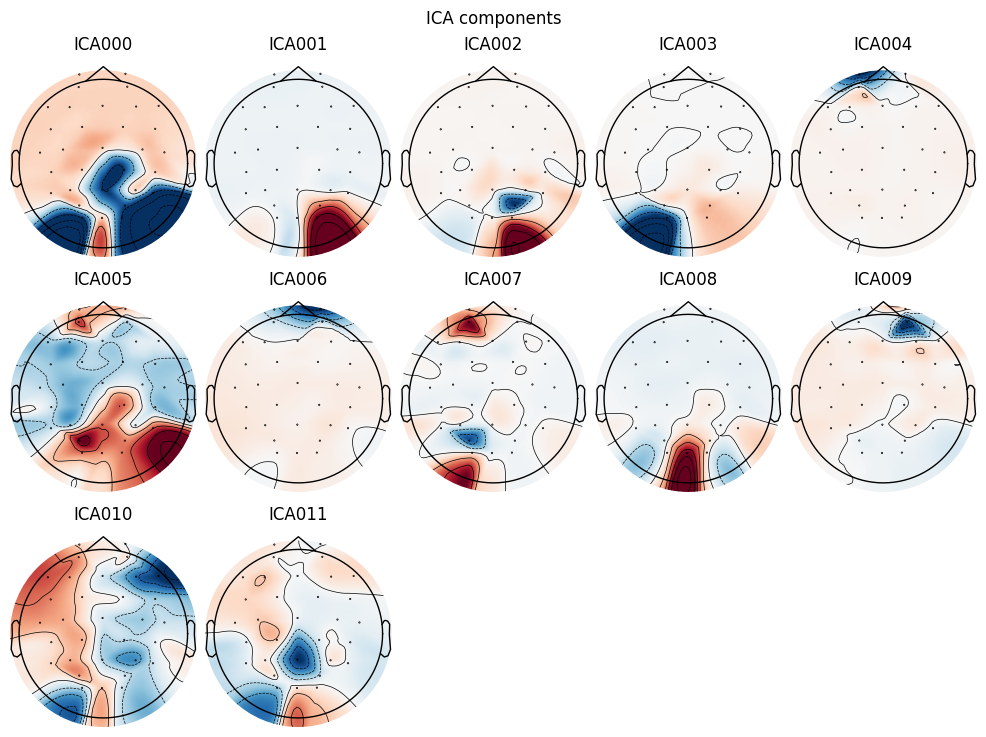

Creating RawArray with float64 data, n_channels=12, n_times=330000
    Range : 0 ... 329999 =      0.000 ...  1319.996 secs
Ready.


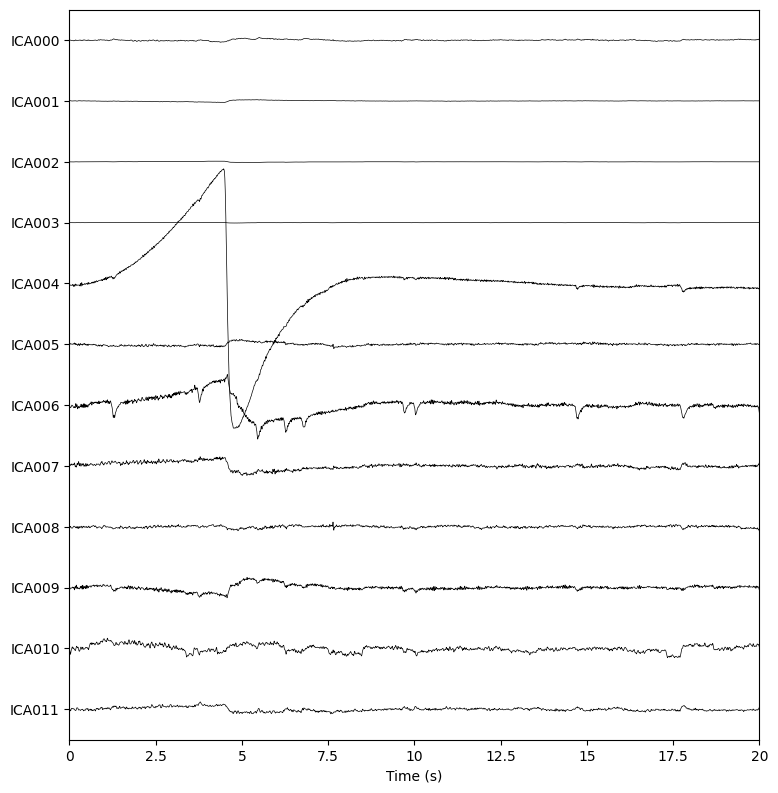


--- ICA Artifact Identification ---
Please review the ICA component plots that just opened.
Identify components associated with artifacts (e.g., eye blinks, muscle activity).
Then, update the `ica.exclude` list in the script with the indices of these components.
For example: `ica.exclude = [0, 1]` if components 0 and 1 are artifacts.
Applying ICA with excluded components: []
ICA artifact correction applied.


In [7]:

# --- 6. Artifact Correction (ICA) ---
print("\nPerforming ICA for artifact correction...")
# It's recommended to run ICA on a copy of the data that is high-pass filtered
# (e.g., >1Hz) to remove slow drifts, but not necessarily very high-frequency
# noise that might interfere with artifact detection.
# For ICA, a copy of the ERP-filtered data is suitable.
ica_raw = raw_filtered_erp.copy()

# Fit ICA model
n_components = 0.99  # Retain enough components to explain 99% variance
random_state = 42   # for reproducibility
ica = mne.preprocessing.ICA(n_components=n_components, random_state=random_state, verbose=False)
try:
    ica.fit(ica_raw)
    print("ICA fit complete.")

    # Plot ICA components to visually identify artifacts (e.g., eye blinks, muscle activity)
    # IMPORTANT: After running the script, review these plots.
    # Identify components that represent artifacts (e.g., clear eye blink patterns, muscle noise).
    # Then, update the `ica.exclude` list with the indices of these components.
    # Example: if components 0 and 1 are artifacts, set ica.exclude = [0, 1]
    ica.plot_components(picks=range(ica.n_components_))
    ica.plot_sources(ica_raw, show_scrollbars=False)

    print("\n--- ICA Artifact Identification ---")
    print("Please review the ICA component plots that just opened.")
    print("Identify components associated with artifacts (e.g., eye blinks, muscle activity).")
    print("Then, update the `ica.exclude` list in the script with the indices of these components.")
    print("For example: `ica.exclude = [0, 1]` if components 0 and 1 are artifacts.")
    # Set ica.exclude AFTER manual inspection. Placeholder example:
    ica.exclude = [] # Manually update this list based on visual inspection of ICA plots

    # Apply ICA solution to remove artifacts
    print(f"Applying ICA with excluded components: {ica.exclude}")
    raw_ica_corrected = ica.apply(raw_filtered_erp.copy(), exclude=ica.exclude, verbose=False)
    raw_ica_corrected_psd = ica.apply(raw_filtered_psd.copy(), exclude=ica.exclude, verbose=False)
    print("ICA artifact correction applied.")

except Exception as e:
    print(f"Error during ICA: {e}")
    print("Skipping ICA correction. Proceeding with raw_filtered_erp/psd.")
    raw_ica_corrected = raw_filtered_erp.copy()
    raw_ica_corrected_psd = raw_filtered_psd.copy()

In [9]:
# --- 7. Epoching (Marker-Based) ---
print("\nEpoching data based on markers...")
all_epochs = {}

for erp_name, params in erp_epoch_params.items():
    print(f"  Epoching for {erp_name}...")
    event_ids_for_erp = {eid_name: custom_event_id[eid_name] for eid_name in params['event_ids']}

    # Automatic rejection thresholds
    reject_criteria = dict(eeg=params['reject_peak_to_peak'])

    try:
        epochs = mne.Epochs(
            raw_ica_corrected,
            events,
            event_id=event_ids_for_erp,
            tmin=params['tmin'],
            tmax=params['tmax'],
            baseline=params['baseline'],
            preload=True,
            reject=reject_criteria,
            proj=True, # Apply SSP projections if any were defined (e.g. from EOG channels if they were kept as non-EEG)
            verbose=False
        )
        print(f"    {len(epochs.events)} epochs created for {erp_name}.")
        print(f"    Number of good epochs after rejection for {erp_name}: {len(epochs)}")
        all_epochs[erp_name] = epochs

    except Exception as e:
        print(f"    Error creating epochs for {erp_name}: {e}")
        all_epochs[erp_name] = None


Epoching data based on markers...
  Epoching for P300...
    30 epochs created for P300.
    Number of good epochs after rejection for P300: 30
  Epoching for N200...
    31 epochs created for N200.
    Number of good epochs after rejection for N200: 31
  Epoching for FRN...
    12 epochs created for FRN.
    Number of good epochs after rejection for FRN: 12


In [11]:
# --- 8. ERP Averaging and Visualization ---
print("\nPerforming ERP averaging and visualization...")
all_evokeds = {}

for erp_name, epochs in all_epochs.items():
    if epochs is not None and len(epochs) > 0:
        print(f"  Averaging ERP for {erp_name}...")
        evoked = epochs.average(picks=params['electrodes']) # Average over specified electrodes for ERP
        all_evokeds[erp_name] = evoked

        # Plot ERP
        fig_erp = evoked.plot(
            spatial_colors=True,
            gfp=True,
            units=dict(eeg='uV'),
            scalings=dict(eeg='auto'),
            titles=f'{erp_name} ERP',
            window_title=f'{erp_name} ERP',
            show=False
        )
        fig_erp.savefig(os.path.join(output_dir, f'{erp_name}_ERP.png'))
        plt.close(fig_erp)
        print(f"    Saved {erp_name} ERP plot to {output_dir}/{erp_name}_ERP.png")

    #     # Optionally plot comparison for different conditions within an ERP (e.g., win vs loss for FRN)
    #     if erp_name == 'FRN':
    #         if 'win' in custom_event_id and 'loose' in custom_event_id:
    #             epochs_win = epochs[epochs.events[:, 2] == custom_event_id['win']]
    #             epochs_loose = epochs[epochs.events[:, 2] == custom_event_id['loose']]

    #             if len(epochs_win) > 0 and len(epochs_loose) > 0:
    #                 evoked_win = epochs_win.average(picks=params['electrodes'])
    #                 evoked_loose = epochs_loose.average(picks=params['electrodes'])

    #                 fig_frn_compare = mne.viz.plot_compare_evokeds(
    #                     dict(Win=evoked_win, Loss=evoked_loose),
    #                     picks=params['electrodes'],
    #                     title='FRN: Win vs Loss',
    #                     show=False
    #                 )
    #                 fig_frn_compare[0].savefig(os.path.join(output_dir, 'FRN_Win_Loss_Compare.png'))
    #                 plt.close(fig_frn_compare[0])
    #                 print(f"    Saved FRN Win vs Loss comparison plot to {output_dir}/FRN_Win_Loss_Compare.png")
    #             else:
    #                 print("    Not enough epochs for FRN Win/Loss comparison.")
    #         else:
    #             print("    'win' or 'loose' event IDs not found for FRN comparison.")
    # else:
    #     print(f"  Skipping averaging for {erp_name}: No good epochs found.")


Performing ERP averaging and visualization...
  Averaging ERP for P300...


ValueError: Channel(s) [np.str_('FCz'), np.str_('CPz')] could not be picked, because they are not present in the info instance.

OG

Loading EDF file: 20250618170033_test_marker_update_9_EEG MAIN STUDY.edf

EEG channel names (from EDF, BEFORE renaming): ['P8', 'T8', 'CP6', 'FC6', 'F8', 'F4', 'C4', 'P4', 'AF4', 'Fp2', 'Fp1', 'AF3', 'Fz', 'FC2', 'Cz', 'CP2', 'PO3', 'O1', 'Oz', 'O2', 'PO4', 'Pz', 'CP1', 'FC1', 'P3', 'C3', 'F3', 'F7', 'FC5', 'CP5', 'T7', 'P7']
NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


C:\Users\suryansh\AppData\Local\Temp\ipykernel_11508\2429745958.py:71: RuntimeWarning: Channels contain different highpass filters. Highest filter setting will be stored.
  raw = mne.io.read_raw_edf(edf_file_path, preload=True, verbose=False)


EDF file loaded successfully.
Original sampling frequency: 500.0 Hz
Number of EEG channels selected: 32
Loading marker CSV file: 20250618170033_test_marker_update_9_EEG MAIN STUDY (1).csv
Found 197 events from CSV.
Example events (sample, duration, event_id):
[[3062    0    2]
 [4070    0    3]
 [4290    0    4]
 [6825    0    1]
 [7643    0    2]]
Custom event IDs: {'baseline': 1, 'Trivia': 2, 'task_start': 3, 'safe_option': 4, 'win': 5, 'loose': 6, 'reveal': 7, 'Stop': 8}

Applying standard_1020 montage and renaming channels...
Montage applied.
EEG channel names (AFTER renaming attempts & montage): ['P8', 'T8', 'CP6', 'FC6', 'F8', 'F4', 'C4', 'P4', 'AF4', 'Fp2', 'Fp1', 'AF3', 'Fz', 'FC2', 'Cz', 'CP2', 'PO3', 'O1', 'Oz', 'O2', 'PO4', 'Pz', 'CP1', 'FC1', 'P3', 'C3', 'F3', 'F7', 'FC5', 'CP5', 'T7', 'P7']

Applying band-pass filter (0.1-30 Hz) for ERP analysis...
Applying band-pass filter (1-45 Hz) for PSD analysis...
Applying notch filter at 50 Hz to both filtered copies...

Downsamplin

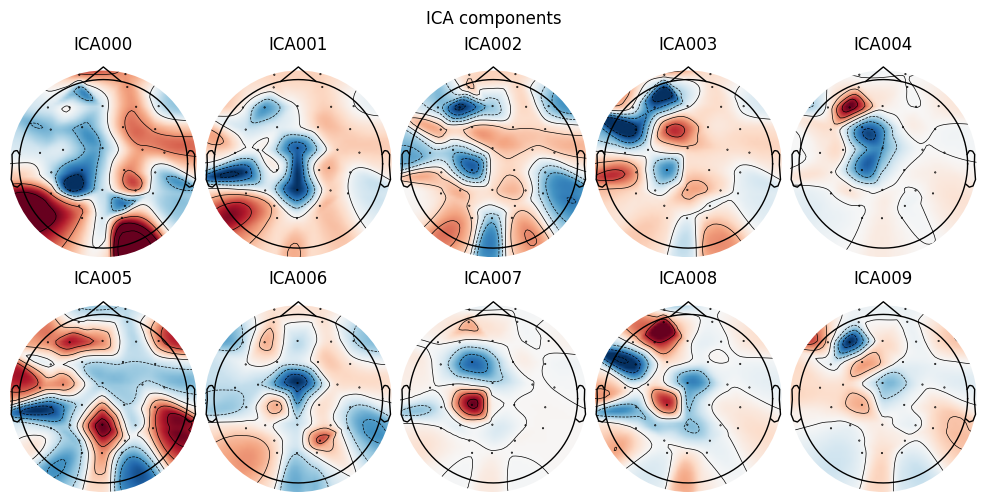

Creating RawArray with float64 data, n_channels=10, n_times=163750
    Range : 0 ... 163749 =      0.000 ...   654.996 secs
Ready.
Using matplotlib as 2D backend.


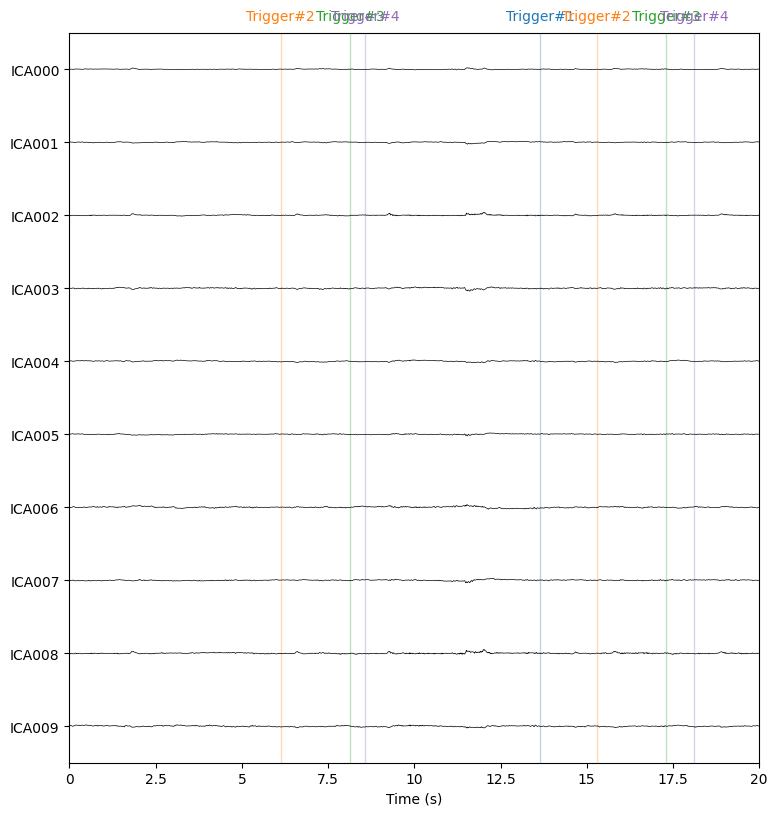


--- ICA Artifact Identification ---
Please review the ICA component plots that just opened.
Identify components associated with artifacts (e.g., eye blinks, muscle activity).
Then, update the `ica.exclude` list in the script with the indices of these components.
For example: `ica.exclude = [0, 1]` if components 0 and 1 are artifacts.
Applying ICA with excluded components: []
ICA artifact correction applied.

Epoching data based on markers...
  Epoching for P300...
    23 epochs created for P300.
    Number of good epochs after rejection for P300: 23
  Epoching for N200...
    18 epochs created for N200.
    Number of good epochs after rejection for N200: 18
  Epoching for FRN...
    6 epochs created for FRN.
    Number of good epochs after rejection for FRN: 6


In [1]:
import mne
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import re

# --- Configuration ---
# TODO: REPLACE THIS WITH THE ACTUAL PATH TO YOUR EDF FILE
edf_file_path = '20250618170033_test_marker_update_9_EEG MAIN STUDY.edf' 
# The CSV marker file is already uploaded, so we can access it directly.
marker_csv_file_name = '20250618170033_test_marker_update_9_EEG MAIN STUDY (1).csv'

output_dir = 'eeg_analysis_results'
os.makedirs(output_dir, exist_ok=True)

sfreq_original = 500  # Original sampling frequency in Hz
sfreq_resample = 250  # Target downsampling frequency in Hz

# Mapping for the numerical markers from your CSV
event_id_mapping = {
    1: 'baseline',
    2: 'Trivia',
    3: 'task_start',
    4: 'safe_option',
    5: 'win',
    6: 'loose',
    7: 'reveal',
    8: 'Stop'
}

# Define epoching parameters for each ERP
# P300: 'BINARY_TASK_START' -> 'CHOICE_A/B/R'
# Assuming 'CHOICE_A/B/R' refers to the response markers: 'safe_option', 'win', 'loose'
# We will epoch on these response markers.
erp_epoch_params = {
    'P300': {
        'event_ids': ['safe_option', 'win', 'loose'], # Numerical markers 4, 5, 6
        'tmin': -0.2, 'tmax': 0.8,
        'baseline': (-0.2, 0),
        'electrodes': ['Pz',  'Cz', 'P3', 'P4', 'Fz', 'Oz'],
        'reject_peak_to_peak': 200e-6 # 200 uV
    },
    'N200': {
        'event_ids': ['Trivia'], # Numerical marker 2. Assuming 'Trivia' signifies Trivia Response onset.
        'tmin': -0.2, 'tmax': 0.5,
        'baseline': (-0.2, 0),
        'electrodes': ['Fz', 'Cz'],
        'reject_peak_to_peak': 150e-6 # 150 uV
    },
    'FRN': {
        'event_ids': ['win', 'loose'], # Numerical markers 5, 6. Assuming these are feedback.
        'tmin': -0.2, 'tmax': 0.6,
        'baseline': (-0.2, 0),
        'electrodes': [ 'Cz'],
        'reject_peak_to_peak': 150e-6 # 150 uV
    }
}

# Define frequency bands for PSD analysis
psd_bands = {
    'Theta': [4, 7],
    'Alpha': [8, 12],
    'Beta': [13, 30]
}


# --- 1. Raw Data Import and Marker Processing ---
print(f"Loading EDF file: {edf_file_path}")
try:
    raw = mne.io.read_raw_edf(edf_file_path, preload=True, verbose=False)
    raw.drop_channels(['X', 'Y', 'Z'])  # Drop non-EEG channels if they exist
    raw.ch_names
    
    # Print channel names BEFORE any renaming/montage
    print(f"\nEEG channel names (from EDF, BEFORE renaming): {raw.ch_names}")

    # Set channel types to 'eeg' and extract EEG channels
    # Be careful if your EDF has other channels like EOG, ECG with 'EEG' in their name.
    # Adjust this line if you need to specifically exclude non-EEG channels that might have 'EEG' in their name.
    eeg_channels = [ch_name for ch_name in raw.ch_names if 'EEG' in ch_name or ch_name.replace(' ', '') in [
        'Fp1', 'Fp2', 'AF3','AF4' ,'F7', 'F3', 'Fz', 'F4', 'F8', 'FC5', 'FC1', 'FC2', 'FC6',
        'T7', 'C3', 'Cz', 'C4', 'T8', 'CP5', 'CP1', 'CP2', 'CP6', 'P7', 'P3',
        'Pz', 'P4', 'P8', 'PO3','PO4', 'O1', 'O2', 'Oz' # Common 10-20/10-10 names
    ]]
    raw.set_channel_types({ch_name: 'eeg' for ch_name in eeg_channels})
    raw.pick_types(eeg=True, meg=False, stim=False, eog=False, exclude='bads') # eog=True if you have EOG channels you want to keep for ICA

    print("EDF file loaded successfully.")
    print(f"Original sampling frequency: {raw.info['sfreq']} Hz")
    print(f"Number of EEG channels selected: {len(raw.ch_names)}")


except FileNotFoundError:
    print(f"Error: EDF file not found at {edf_file_path}. Please update 'edf_file_path'.")
    exit()
except Exception as e:
    print(f"Error loading EDF file: {e}")
    exit()


# Load and process markers from CSV
print(f"Loading marker CSV file: {marker_csv_file_name}")
try:
    # Read the CSV as a single column of numbers
    marker_data = pd.read_csv(marker_csv_file_name, header=None).iloc[:, 0].values

    # Find non-zero markers and their sample indices
    # We assume the index corresponds to the sample number
    event_samples = np.where(marker_data != 0)[0]
    event_values = marker_data[event_samples]

    # Create the MNE events array: [sample, 0, event_id]
    # MNE events array expects sample indices relative to the start of the raw data.
    # We assume the CSV samples are already in the same time basis as the EDF.
    events = np.column_stack((event_samples, np.zeros_like(event_samples), event_values)).astype(int)

    # Create MNE event_id dictionary for annotations
    custom_event_id = {name: id for id, name in event_id_mapping.items()}

    print(f"Found {len(events)} events from CSV.")
    print("Example events (sample, duration, event_id):")
    print(events[:5]) # Print first 5 events
    print("Custom event IDs:", custom_event_id)

except FileNotFoundError:
    print(f"Error: Marker CSV file not found: {marker_csv_file_name}.")
    exit()
except Exception as e:
    print(f"Error processing marker CSV: {e}")
    exit()


# --- 2. Channel and Montage Configuration ---
print("\nApplying standard_1020 montage and renaming channels...")
# Standard 10-20 montage
montage = mne.channels.make_standard_montage('standard_1020')

# Channel renaming dictionary (add more if your EDF channel names differ)
# IMPORTANT: You MUST inspect the "EEG channel names (from EDF, BEFORE renaming)"
# output and populate this dictionary to map your Starstim channel names
# to standard 10-20 names (e.g., 'Fp1', 'Cz', 'Pz').
# Example: If your EDF has 'EEG 001' and that corresponds to 'Fp1', add:
# channel_rename_map['EEG 001'] = 'Fp1'
# channel_rename_map = {
#     # 'Original_Starstim_Name_1': 'Fp1',
#     # 'Original_Starstim_Name_2': 'Fp2',
#     # ... fill this out based on your EDF's channel names
#     # e.g., if Starstim gives 'E1' for Fpz, 'E2' for Fp1, etc.
#     # 'E1': 'Fp1',
#     # 'E2': 'Fp2',
#     # 'E3': 'F7',
#     # ...
#     # Make sure 'FCz', 'CPz' and other required electrodes are mapped correctly!
# }

# Attempt to automatically find and rename common patterns, but manual mapping is best.
# for ch_name in raw.ch_names:
#     # Example: If your channels are like 'Fp1-EEG', 'Cz-EEG'
#     match = re.match(r'([A-Za-z0-9_]+)-EEG', ch_name)
#     if match and match.group(1) not in channel_rename_map.values(): # Only add if not already manually mapped
#         channel_rename_map[ch_name] = match.group(1)
#     # Another common pattern if channel names are like 'EEG Fp1'
#     match_prefix = re.match(r'EEG\s*([A-Za-z0-9_]+)', ch_name)
#     if match_prefix and match_prefix.group(1) not in channel_rename_map.values():
#         channel_rename_map[ch_name] = match_prefix.group(1)


# # Rename channels in raw data
# if channel_rename_map:
#     raw.rename_channels(channel_rename_map)
#     print(f"Channels renamed using provided map: {channel_rename_map}")
# else:
#     print("No custom channel renaming map provided or found for common patterns. Channels might not match montage names.")

# Apply montage
# MNE will attempt to match raw.ch_names to the montage's channel names
raw.set_montage(montage, on_missing='warn')
print("Montage applied.")
print(f"EEG channel names (AFTER renaming attempts & montage): {raw.ch_names}")


# --- 3. Filtering ---
# Band-pass filter for ERP (0.1-30 Hz)
print("\nApplying band-pass filter (0.1-30 Hz) for ERP analysis...")
raw_filtered_erp = raw.copy().filter(l_freq=0.1, h_freq=30, fir_design='firwin', verbose=False)

# Band-pass filter for PSD (1-45 Hz)
print("Applying band-pass filter (1-45 Hz) for PSD analysis...")
raw_filtered_psd = raw.copy().filter(l_freq=1, h_freq=45, fir_design='firwin', verbose=False)

# Notch filter (50 Hz)
print("Applying notch filter at 50 Hz to both filtered copies...")
raw_filtered_erp.notch_filter(freqs=50, fir_design='firwin', verbose=False)
raw_filtered_psd.notch_filter(freqs=50, fir_design='firwin', verbose=False)


# --- 4. Downsampling ---
print(f"\nDownsampling data to {sfreq_resample} Hz...")
raw_filtered_erp.resample(sfreq=sfreq_resample, verbose=False)
raw_filtered_psd.resample(sfreq=sfreq_resample, verbose=False)
print(f"Data resampled. New sampling frequency: {raw_filtered_erp.info['sfreq']} Hz")


# --- 5. Re-referencing (Common Average Reference) ---
print("\nApplying Common Average Reference (CAR)...")
raw_filtered_erp.set_eeg_reference('average', projection=False, verbose=False)
raw_filtered_psd.set_eeg_reference('average', projection=False, verbose=False)
print("CAR applied.")



# --- 6. Artifact Correction (ICA) ---
print("\nPerforming ICA for artifact correction...")
# It's recommended to run ICA on a copy of the data that is high-pass filtered
# (e.g., >1Hz) to remove slow drifts, but not necessarily very high-frequency
# noise that might interfere with artifact detection.
# For ICA, a copy of the ERP-filtered data is suitable.
ica_raw = raw_filtered_erp.copy()

# Fit ICA model
n_components = 0.99  # Retain enough components to explain 99% variance
random_state = 42   # for reproducibility
ica = mne.preprocessing.ICA(n_components=n_components, random_state=random_state, verbose=False)
try:
    ica.fit(ica_raw)
    print("ICA fit complete.")

    # Plot ICA components to visually identify artifacts (e.g., eye blinks, muscle activity)
    # IMPORTANT: After running the script, review these plots.
    # Identify components that represent artifacts (e.g., clear eye blink patterns, muscle noise).
    # Then, update the `ica.exclude` list with the indices of these components.
    # Example: if components 0 and 1 are artifacts, set ica.exclude = [0, 1]
    ica.plot_components(picks=range(ica.n_components_))
    ica.plot_sources(ica_raw, show_scrollbars=False)

    print("\n--- ICA Artifact Identification ---")
    print("Please review the ICA component plots that just opened.")
    print("Identify components associated with artifacts (e.g., eye blinks, muscle activity).")
    print("Then, update the `ica.exclude` list in the script with the indices of these components.")
    print("For example: `ica.exclude = [0, 1]` if components 0 and 1 are artifacts.")
    # Set ica.exclude AFTER manual inspection. Placeholder example:
    ica.exclude = [] # Manually update this list based on visual inspection of ICA plots

    # Apply ICA solution to remove artifacts
    print(f"Applying ICA with excluded components: {ica.exclude}")
    raw_ica_corrected = ica.apply(raw_filtered_erp.copy(), exclude=ica.exclude, verbose=False)
    raw_ica_corrected_psd = ica.apply(raw_filtered_psd.copy(), exclude=ica.exclude, verbose=False)
    print("ICA artifact correction applied.")

except Exception as e:
    print(f"Error during ICA: {e}")
    print("Skipping ICA correction. Proceeding with raw_filtered_erp/psd.")
    raw_ica_corrected = raw_filtered_erp.copy()
    raw_ica_corrected_psd = raw_filtered_psd.copy()




# --- 7. Epoching (Marker-Based) ---
print("\nEpoching data based on markers...")
all_epochs = {}

for erp_name, params in erp_epoch_params.items():
    print(f"  Epoching for {erp_name}...")
    event_ids_for_erp = {eid_name: custom_event_id[eid_name] for eid_name in params['event_ids']}

    # Check if all required electrodes are present in the raw data
    missing_electrodes = [e for e in params['electrodes'] if e not in raw_ica_corrected.ch_names]
    if missing_electrodes:
        print(f"    WARNING: Skipping {erp_name} epoching. Required electrodes not found: {missing_electrodes}")
        all_epochs[erp_name] = None
        continue # Skip to the next ERP

    # Automatic rejection thresholds
    reject_criteria = dict(eeg=params['reject_peak_to_peak'])

    try:
        epochs = mne.Epochs(
            raw_ica_corrected,
            events,
            event_id=event_ids_for_erp,
            tmin=params['tmin'],
            tmax=params['tmax'],
            baseline=params['baseline'],
            preload=True,
            reject=reject_criteria,
            proj=True, # Apply SSP projections if any were defined (e.g. from EOG channels if they were kept as non-EEG)
            verbose=False
        )
        print(f"    {len(epochs.events)} epochs created for {erp_name}.")
        print(f"    Number of good epochs after rejection for {erp_name}: {len(epochs)}")
        all_epochs[erp_name] = epochs

    except Exception as e:
        print(f"    Error creating epochs for {erp_name}: {e}")
        all_epochs[erp_name] = None


In [2]:

# --- 8. ERP Averaging and Visualization ---
print("\nPerforming ERP Averaging and Visualization...")

for erp_name, params in erp_epoch_params.items():
    epochs = all_epochs.get(erp_name)

    if epochs is None or len(epochs) == 0:
        print(f"  No valid epochs found for {erp_name}. Skipping ERP averaging and plotting.")
        continue

    print(f"  Processing {erp_name} ERP...")

    if len(params['event_ids']) == 1:
        # Single condition ERP (e.g., P300, N200 as per current setup)
        evoked = epochs.average()
        print(f"    Computed average evoked for {erp_name}.")

        # Plot averaged ERP
        try:
            fig_erp = evoked.plot(
                picks=params['electrodes'],
                spatial_colors=True,
                gfp=True,
                titles=f'{erp_name} ERP on {", ".join(params["electrodes"])}',
                window_title=f'{erp_name} ERP',
                show=False # Do not show interactively, save instead
            )
            fig_erp.savefig(os.path.join(output_dir, f'{erp_name}_ERP_averaged.png'))
            plt.close(fig_erp) # Close the figure to free memory
            print(f"    Saved averaged ERP plot: {erp_name}_ERP_averaged.png")
        except Exception as e:
            print(f"    Error plotting {erp_name} ERP: {e}")

        # Plot Topomaps for selected time points
        # Adjust times based on tmax and expected component latency
        times_for_topo = np.arange(0.1, params['tmax'] * 0.8, 0.1) # Plot topomaps every 100ms up to 80% of tmax
        if len(times_for_topo) > 0:
            try:
                fig_topo = evoked.plot_topomap(
                    times=times_for_topo,
                    title=f'{erp_name} Topomap at {int(times_for_topo*1000)} ms'({", ".join(evoked.ch_names)})', # Include channel names in title

                    average=0.05,
                    show=False
                )
                fig_topo.savefig(os.path.join(output_dir, f'{erp_name}_ERP_topomap.png'))
                plt.close(fig_topo)
                print(f"    Saved {erp_name} topomap plot: {erp_name}_ERP_topomap.png")
            except Exception as e:
                print(f"    Error plotting {erp_name} topomap: {e}")
        else:
            print(f"    Not enough time points for topomap for {erp_name}. Skipping topomap plot.")

    elif len(params['event_ids']) > 1:
        # Multiple conditions within an ERP (e.g., FRN with 'win' and 'loose')
        print(f"    Comparing conditions for {erp_name}: {params['event_ids']}")
        
        evoked_conditions = {}
        for condition_name in params['event_ids']:
            try:
                # Select epochs for the specific condition
                # Use .get() to safely access epochs for a specific condition
                epochs_condition = epochs[condition_name]
                if len(epochs_condition) > 0:
                    evoked_conditions[condition_name] = epochs_condition.average()
                    print(f"      Computed evoked for condition: {condition_name} ({len(epochs_condition)} epochs)")
                else:
                    print(f"      No good epochs for condition: {condition_name}. Skipping.")
            except KeyError:
                print(f"      Condition '{condition_name}' not found in epochs for {erp_name}. Skipping.")
            except Exception as e:
                print(f"      Error computing evoked for condition {condition_name}: {e}")

        if len(evoked_conditions) >= 2: # Need at least two conditions to compare
            try:
                # mne.viz.plot_compare_evokeds returns a list of figures if `picks` is a list, or a single figure
                fig_compare = mne.viz.plot_compare_evokeds(
                    evoked_conditions,
                    picks=params['electrodes'],
                    title=f'{erp_name} Comparison on {", ".join(params["electrodes"])}',
                    show_sensors=True,
                    show=False
                )
                
                # Ensure fig_compare is treated as a list for consistent saving
                if not isinstance(fig_compare, list):
                    fig_compare = [fig_compare]

                for i, fig in enumerate(fig_compare):
                    fig.savefig(os.path.join(output_dir, f'{erp_name}_comparison_{i+1}.png'))
                    plt.close(fig)
                print(f"    Saved {erp_name} comparison plot(s).")
            except Exception as e:
                print(f"    Error plotting {erp_name} comparison: {e}")
        else:
            print(f"    Not enough conditions with valid epochs to compare for {erp_name}.")

print("\nERP Averaging and Visualization complete.")

# --- Final Step: Close all Matplotlib plots ---
# This will show any plots that were left open (e.g., ICA plots).
# It will block execution until these plots are manually closed by the user.
plt.show() 
plt.close('all') # Close all remaining open plots after they have been shown.

SyntaxError: unterminated string literal (detected at line 41) (4119367816.py, line 41)

In [ ]:
# --- 8. ERP Averaging and Visualization ---
print("\nPerforming ERP Averaging and Visualization...")

for erp_name, params in erp_epoch_params.items():
    epochs = all_epochs.get(erp_name)

    if epochs is None or len(epochs) == 0:
        print(f"  No valid epochs found for {erp_name}. Skipping ERP averaging and plotting.")
        continue

    print(f"  Processing {erp_name} ERP...")

    if len(params['event_ids']) == 1:
        # Single condition ERP (e.g., P300, N200 as per current setup)
        evoked = epochs.average()
        print(f"    Computed average evoked for {erp_name}.")

        # Plot averaged ERP
        try:
            fig_erp = evoked.plot(
                picks=params['electrodes'],
                spatial_colors=True,
                gfp=True,
                titles=f'{erp_name} ERP on {", ".join(params["electrodes"])}',
                window_title=f'{erp_name} ERP',
                show=False
            )

            # Modify x-axis to show milliseconds
            for ax in fig_erp.axes:
                xticks = ax.get_xticks()
                ax.set_xticks(xticks)
                ax.set_xticklabels([f"{int(t * 1000)}" for t in xticks])
                ax.set_xlabel("Time (ms)")

            fig_erp.savefig(os.path.join(output_dir, f'{erp_name}_ERP_averaged.png'))
            plt.close(fig_erp)
            print(f"    Saved averaged ERP plot: {erp_name}_ERP_averaged.png")
        except Exception as e:
            print(f"    Error plotting {erp_name} ERP: {e}")

        # Plot Topomaps for selected time points
        times_for_topo = np.arange(0.1, params['tmax'] * 0.8, 0.1)
        if len(times_for_topo) > 0:
            try:
                fig_topo = evoked.plot_topomap(
                    times=times_for_topo,
                    title=f'{erp_name} Topomap ({", ".join(evoked.ch_names)})',
                    average=0.05,
                    show=False
                )
                fig_topo.savefig(os.path.join(output_dir, f'{erp_name}_ERP_topomap.png'))
                plt.close(fig_topo)
                print(f"    Saved {erp_name} topomap plot: {erp_name}_ERP_topomap.png")
            except Exception as e:
                print(f"    Error plotting {erp_name} topomap: {e}")
        else:
            print(f"    Not enough time points for topomap for {erp_name}. Skipping topomap plot.")

    elif len(params['event_ids']) > 1:
        # Multiple conditions within an ERP
        print(f"    Comparing conditions for {erp_name}: {params['event_ids']}")
        
        evoked_conditions = {}
        for condition_name in params['event_ids']:
            try:
                epochs_condition = epochs[condition_name]
                if len(epochs_condition) > 0:
                    evoked_conditions[condition_name] = epochs_condition.average()
                    print(f"      Computed evoked for condition: {condition_name} ({len(epochs_condition)} epochs)")
                else:
                    print(f"      No good epochs for condition: {condition_name}. Skipping.")
            except KeyError:
                print(f"      Condition '{condition_name}' not found in epochs for {erp_name}. Skipping.")
            except Exception as e:
                print(f"      Error computing evoked for condition {condition_name}: {e}")

        if len(evoked_conditions) >= 2:
            try:
                fig_compare = mne.viz.plot_compare_evokeds(
                    evoked_conditions,
                    picks=params['electrodes'],
                    title=f'{erp_name} Comparison on {", ".join(params["electrodes"])}',
                    show_sensors=True,
                    show=False
                )

+

                if not isinstance(fig_compare, list):
                    fig_compare = [fig_compare]

                for i, fig in enumerate(fig_compare):
                    for ax in fig.axes:
                        xticks = ax.get_xticks()
                        ax.set_xticks(xticks)
                        ax.set_xticklabels([f"{int(t * 1000)}" for t in xticks])
                        ax.set_xlabel("Time (ms)")
                    fig.savefig(os.path.join(output_dir, f'{erp_name}_comparison_{i+1}.png'))
                    plt.close(fig)
                print(f"    Saved {erp_name} comparison plot(s).")
            except Exception as e:
                print(f"    Error plotting {erp_name} comparison: {e}")
        else:
            print(f"    Not enough conditions with valid epochs to compare for {erp_name}.")

print("\nERP Averaging and Visualization complete.")

# --- Final Step: Close all Matplotlib plots ---
plt.show()
plt.close('all')



Performing ERP Averaging and Visualization...
  Processing P300 ERP...
    Comparing conditions for P300: ['safe_option', 'win', 'loose']
      Computed evoked for condition: safe_option (16 epochs)
      Computed evoked for condition: win (1 epochs)
      Computed evoked for condition: loose (6 epochs)
combining channels using GFP (eeg channels)
combining channels using GFP (eeg channels)
combining channels using GFP (eeg channels)
    Saved P300 comparison plot(s).
  Processing N200 ERP...
    Computed average evoked for N200.
    Saved averaged ERP plot: N200_ERP_averaged.png
    Error plotting N200 topomap: Evoked.plot_topomap() got an unexpected keyword argument 'title'
  Processing FRN ERP...
    Comparing conditions for FRN: ['win', 'loose']
      Computed evoked for condition: win (1 epochs)
      Computed evoked for condition: loose (5 epochs)
    Saved FRN comparison plot(s).

ERP Averaging and Visualization complete.


In [ ]:
# --- 9. PSD Analysis ---
print("\nPerforming Power Spectral Density (PSD) Analysis (Multitaper method)...")

# Electrodes for PSD analysis: All EEG channels
psd_electrodes = raw_ica_corrected_psd.ch_names
print(f"  Performing PSD analysis on electrodes: {', '.join(psd_electrodes)}")

try:
    # Compute PSD using Multitaper method directly from the Raw object
    psd = raw_ica_corrected_psd.compute_psd(
        method="multitaper",
        fmin=psd_bands['Theta'][0],
        fmax=psd_bands['Beta'][1] + 5,
        picks='eeg', 
        verbose=False
    )

    # Convert PSDs to dB for plotting (10 * log10(power))
    psds = 10 * np.log10(psd.get_data())  # PSD in dB
    freqs = psd.freqs

    print("  PSD computation complete.")

    # Plot overall PSD for selected electrodes
    fig_psd_overall, ax = plt.subplots(figsize=(10, 6))
    ax.plot(freqs, psds.T, color='gray', alpha=0.5)  # Each channel
    ax.plot(freqs, psds.mean(axis=0), color='blue', linewidth=2, label='Mean PSD')

    # Define custom colors for each frequency band
    band_colors = {
        'Theta': 'purple',
        'Alpha': 'green',
        'Beta': 'orange'
    }

    # Highlight frequency bands with different colors
    for band_name, freq_range in psd_bands.items():
        color = band_colors.get(band_name, 'gray')  # fallback to gray if undefined
        ax.axvspan(freq_range[0], freq_range[1], color=color, alpha=0.2, label=band_name)

    ax.set_title('Overall Power Spectral Density (PSD) for EEG Channels (Multitaper)')
    ax.set_xlabel('Frequency (Hz)')
    ax.set_ylabel('Power/Frequency (dB/Hz)')
    ax.set_xlim(0, psd_bands['Beta'][1] + 10)
    ax.set_ylim(psds.min() - 5, psds.max() + 5)

    # Avoid duplicate legend entries
    handles, labels = ax.get_legend_handles_labels()
    unique = dict(zip(labels, handles))
    ax.legend(unique.values(), unique.keys(), loc='upper right')

    fig_psd_overall.tight_layout()
    fig_psd_overall.savefig(os.path.join(output_dir, 'overall_psd_multitaper.png'))
    plt.close(fig_psd_overall)
    print("  Saved overall PSD plot: overall_psd_multitaper.png")

    # Calculate average power for each band and plot as a bar chart
    band_powers = {}
    for band_name, freq_range in psd_bands.items():
        fmin, fmax = freq_range
        idx_band = np.where((freqs >= fmin) & (freqs <= fmax))[0]
        mean_power = psds[:, idx_band].mean()
        band_powers[band_name] = mean_power

    fig_band_power, ax = plt.subplots(figsize=(8, 5))
    ax.bar(band_powers.keys(), band_powers.values(), color=[band_colors.get(b, 'gray') for b in band_powers.keys()])
    ax.set_title('Average Power in Defined Frequency Bands (Multitaper)')
    ax.set_xlabel('Frequency Band')
    ax.set_ylabel('Average Power (dB/Hz)')
    fig_band_power.tight_layout()
    fig_band_power.savefig(os.path.join(output_dir, 'band_power_bars_multitaper.png'))
    plt.close(fig_band_power)
    print("  Saved band power bar chart: band_power_bars_multitaper.png")

except Exception as e:
    print(f"Error during PSD analysis: {e}")

print("\nPSD Analysis complete.")

# --- Final Step: Close all Matplotlib plots ---
plt.show()
plt.close('all')



Performing Power Spectral Density (PSD) Analysis (Multitaper method)...
  Performing PSD analysis on electrodes: P8, T8, CP6, FC6, F8, F4, C4, P4, AF4, Fp2, Fp1, AF3, Fz, FC2, Cz, CP2, PO3, O1, Oz, O2, PO4, Pz, CP1, FC1, P3, C3, F3, F7, FC5, CP5, T7, P7
  PSD computation complete.
  Saved overall PSD plot: overall_psd_multitaper.png
  Saved band power bar chart: band_power_bars_multitaper.png

PSD Analysis complete.


by welch

In [ ]:
# # --- 9. PSD Analysis ---
# print("\nPerforming Power Spectral Density (PSD) Analysis (Welch method)...")

# # Electrodes for PSD analysis: All EEG channels
# psd_electrodes = raw_ica_corrected_psd.ch_names
# print(f"  Performing PSD analysis on electrodes: {', '.join(psd_electrodes)}")

# try:
#     # Compute PSD using Welch method directly from the Raw object
#     # fmax can be set to raw_ica_corrected_psd.info['sfreq'] / 2 for Nyquist frequency
#     psd = raw_ica_corrected_psd.compute_psd(
#         method="multitaper",
#         fmin=psd_bands['Theta'][0],
#         fmax=psd_bands['Beta'][1] + 5,
#         picks='eeg',
#         verbose=False
#     )

#     # Convert PSDs to dB for plotting (10 * log10(power))
#     psds = 10 * np.log10(psd.get_data())  # PSD in dB
#     freqs = psd.freqs
#     print("  PSD computation complete.")

#     # Plot overall PSD for selected electrodes
#     fig_psd_overall, ax = plt.subplots(figsize=(10, 6))
#     ax.plot(freqs, psds.T, color='gray', alpha=0.5) # Plot each channel's PSD
#     ax.plot(freqs, psds.mean(axis=0), color='blue', linewidth=2, label='Mean PSD') # Plot mean PSD
    
#     # Highlight frequency bands
#     for band_name, freq_range in psd_bands.items():
#         ax.axvspan(freq_range[0], freq_range[1], color='red', alpha=0.1, label=band_name)
        
#     ax.set_title('Overall Power Spectral Density (PSD) for EEG Channels (Welch)')
#     ax.set_xlabel('Frequency (Hz)')
#     ax.set_ylabel('Power/Frequency (dB/Hz)')
#     ax.set_xlim(0, psd_bands['Beta'][1] + 10) # Set x-axis limit slightly above max beta frequency
#     ax.set_ylim(psds.min() - 5, psds.max() + 5) # Adjust y-axis for better visualization
#     ax.legend(loc='upper right')
#     fig_psd_overall.tight_layout()
#     fig_psd_overall.savefig(os.path.join(output_dir, 'overall_psd_welch.png'))
#     plt.close(fig_psd_overall)
#     print("  Saved overall PSD plot: overall_psd_welch.png")

#     # Calculate average power for each band and plot as a bar chart (optional, but useful)
#     band_powers = {}
#     for band_name, freq_range in psd_bands.items():
#         fmin, fmax = freq_range
#         idx_band = np.where((freqs >= fmin) & (freqs <= fmax))[0]
#         # Calculate mean power within the band for all channels, then average across channels
#         mean_power = psds[:, idx_band].mean()
#         band_powers[band_name] = mean_power

#     fig_band_power, ax = plt.subplots(figsize=(8, 5))
#     ax.bar(band_powers.keys(), band_powers.values(), color=['skyblue', 'lightcoral', 'lightgreen'])
#     ax.set_title('Average Power in Defined Frequency Bands (Welch)')
#     ax.set_xlabel('Frequency Band')
#     ax.set_ylabel('Average Power (dB/Hz)')
#     fig_band_power.tight_layout()
#     fig_band_power.savefig(os.path.join(output_dir, 'band_power_bars_welch.png'))
#     plt.close(fig_band_power)
#     print("  Saved band power bar chart: band_power_bars_welch.png")

# except Exception as e:
#     print(f"Error during PSD analysis: {e}")

# print("\nPSD Analysis complete.")

# # --- Final Step: Close all Matplotlib plots ---
# # This will show any plots that were left open (e.g., ICA plots).
# # It will block execution until these plots are manually closed by the user.
# plt.show() 
# plt.close('all') # Close all remaining open plots after they have been shown.



Performing Power Spectral Density (PSD) Analysis (Welch method)...
  Performing PSD analysis on electrodes: P8, T8, CP6, FC6, F8, F4, C4, P4, AF4, Fp2, Fp1, AF3, Fz, FC2, Cz, CP2, PO3, O1, Oz, O2, PO4, Pz, CP1, FC1, P3, C3, F3, F7, FC5, CP5, T7, P7
  PSD computation complete.
  Saved overall PSD plot: overall_psd_welch.png
  Saved band power bar chart: band_power_bars_welch.png

PSD Analysis complete.


In [6]:
# --- 8. ERP Averaging and Visualization ---
print("\nPerforming ERP Averaging and Visualization...")

# Store evoked objects for later use in Topomaps and Export
evoked_responses = {} 

for erp_name, params in erp_epoch_params.items():
    epochs = all_epochs.get(erp_name)

    if epochs is None or len(epochs) == 0:
        print(f"  No valid epochs found for {erp_name}. Skipping ERP averaging and plotting.")
        evoked_responses[erp_name] = None # Store None if no epochs
        continue

    print(f"  Processing {erp_name} ERP...")

    if len(params['event_ids']) == 1:
        # Single condition ERP (e.g., P300, N200 as per current setup)
        evoked = epochs.average()
        evoked_responses[erp_name] = evoked # Store the evoked object
        print(f"    Computed average evoked for {erp_name}.")

        # Plot averaged ERP
        try:
            fig_erp = evoked.plot(
                picks=params['electrodes'],
                spatial_colors=True,
                gfp=True,
                titles=f'{erp_name} ERP on {", ".join(params["electrodes"])}',
                window_title=f'{erp_name} ERP',
                show=False # Do not show interactively, save instead
            )
            fig_erp.savefig(os.path.join(output_dir, f'{erp_name}_ERP_averaged.png'))
            plt.close(fig_erp) # Close the figure to free memory
            print(f"    Saved averaged ERP plot: {erp_name}_ERP_averaged.png")
        except Exception as e:
            print(f"    Error plotting {erp_name} ERP: {e}")

    elif len(params['event_ids']) > 1:
        # Multiple conditions within an ERP (e.g., FRN with 'win' and 'loose')
        print(f"    Comparing conditions for {erp_name}: {params['event_ids']}")
        
        evoked_conditions = {}
        for condition_name in params['event_ids']:
            try:
                # Select epochs for the specific condition
                epochs_condition = epochs[condition_name]
                if len(epochs_condition) > 0:
                    evoked_conditions[condition_name] = epochs_condition.average()
                    print(f"      Computed evoked for condition: {condition_name} ({len(epochs_condition)} epochs)")
                else:
                    print(f"      No good epochs for condition: {condition_name}. Skipping.")
            except KeyError:
                print(f"      Condition '{condition_name}' not found in epochs for {erp_name}. Skipping.")
            except Exception as e:
                print(f"      Error computing evoked for condition {condition_name}: {e}")
        
        evoked_responses[erp_name] = evoked_conditions # Store dictionary of evoked objects for multi-condition ERP

        if len(evoked_conditions) >= 2: # Need at least two conditions to compare
            try:
                fig_compare = mne.viz.plot_compare_evokeds(
                    evoked_conditions,
                    picks=params['electrodes'],
                    title=f'{erp_name} Comparison on {", ".join(params["electrodes"])}',
                    show_sensors=True,
                    show=False
                )
                
                if not isinstance(fig_compare, list):
                    fig_compare = [fig_compare]

                for i, fig in enumerate(fig_compare):
                    fig.savefig(os.path.join(output_dir, f'{erp_name}_comparison_{i+1}.png'))
                    plt.close(fig)
                print(f"    Saved {erp_name} comparison plot(s).")
            except Exception as e:
                print(f"    Error plotting {erp_name} comparison: {e}")
        else:
            print(f"    Not enough conditions with valid epochs to compare for {erp_name}.")

print("\nERP Averaging and Visualization complete.")

# --- 9. PSD Analysis ---
print("\nPerforming Power Spectral Density (PSD) Analysis (Multitaper method)...")

# Electrodes for PSD analysis: All EEG channels
psd_electrodes = raw_ica_corrected_psd.ch_names
print(f"  Performing PSD analysis on electrodes: {', '.join(psd_electrodes)}")

try:
    # Compute PSD using Multitaper method directly from the Raw object
    psd = raw_ica_corrected_psd.compute_psd(
        method="multitaper",
        fmin=psd_bands['Theta'][0],
        fmax=psd_bands['Beta'][1] + 5,
        picks='eeg', 
        verbose=False
    )

    # Convert PSDs to dB for plotting (10 * log10(power))
    psds = 10 * np.log10(psd.get_data())  # PSD in dB
    freqs = psd.freqs

    print("  PSD computation complete.")

    # Plot overall PSD for selected electrodes
    fig_psd_overall, ax = plt.subplots(figsize=(10, 6))
    ax.plot(freqs, psds.T, color='gray', alpha=0.5)  # Each channel
    ax.plot(freqs, psds.mean(axis=0), color='blue', linewidth=2, label='Mean PSD')

    # Define custom colors for each frequency band
    band_colors = {
        'Theta': 'purple',
        'Alpha': 'green',
        'Beta': 'orange'
    }

    # Highlight frequency bands with different colors
    for band_name, freq_range in psd_bands.items():
        color = band_colors.get(band_name, 'gray')  # fallback to gray if undefined
        ax.axvspan(freq_range[0], freq_range[1], color=color, alpha=0.2, label=band_name)

    ax.set_title('Overall Power Spectral Density (PSD) for EEG Channels (Multitaper)')
    ax.set_xlabel('Frequency (Hz)')
    ax.set_ylabel('Power/Frequency (dB/Hz)')
    ax.set_xlim(0, psd_bands['Beta'][1] + 10)
    ax.set_ylim(psds.min() - 5, psds.max() + 5)

    # Avoid duplicate legend entries
    handles, labels = ax.get_legend_handles_labels()
    unique = dict(zip(labels, handles))
    ax.legend(unique.values(), unique.keys(), loc='upper right')

    fig_psd_overall.tight_layout()
    fig_psd_overall.savefig(os.path.join(output_dir, 'overall_psd_multitaper.png'))
    plt.close(fig_psd_overall)
    print("  Saved overall PSD plot: overall_psd_multitaper.png")

    # Calculate average power for each band and plot as a bar chart
    band_powers = {}
    for band_name, freq_range in psd_bands.items():
        fmin, fmax = freq_range
        idx_band = np.where((freqs >= fmin) & (freqs <= fmax))[0]
        mean_power = psds[:, idx_band].mean()
        band_powers[band_name] = mean_power

    fig_band_power, ax = plt.subplots(figsize=(8, 5))
    ax.bar(band_powers.keys(), band_powers.values(), color=[band_colors.get(b, 'gray') for b in band_powers.keys()])
    ax.set_title('Average Power in Defined Frequency Bands (Multitaper)')
    ax.set_xlabel('Frequency Band')
    ax.set_ylabel('Average Power (dB/Hz)')
    fig_band_power.tight_layout()
    fig_band_power.savefig(os.path.join(output_dir, 'band_power_bars_multitaper.png'))
    plt.close(fig_band_power)
    print("  Saved band power bar chart: band_power_bars_multitaper.png")

except Exception as e:
    print(f"Error during PSD analysis: {e}")

print("\nPSD Analysis complete.")

# --- Final Step: Close all Matplotlib plots ---
plt.show()
plt.close('all')




# --- 10. Topographic Maps ---
print("\nGenerating Topographic Maps...")

# ERP Topomaps
print("  Generating ERP Topomaps...")
# Ensure evoked_responses is defined, even if previous steps failed to populate it
if 'evoked_responses' not in globals():
    evoked_responses = {}

for erp_name, params in erp_epoch_params.items():
    evoked_obj = evoked_responses.get(erp_name)

    if evoked_obj is None:
        print(f"    No evoked data found for {erp_name}. Skipping ERP topomaps.")
        continue
    
    # Handle multi-condition ERPs (e.g., FRN) where evoked_obj is a dict
    if isinstance(evoked_obj, dict):
        for cond_name, evoked in evoked_obj.items():
            if evoked is not None:
                try:
                    # Use specified topo_times for ERP
                    fig_topo_erp = evoked.plot_topomap(
                        times=params['topo_times'],
                        ch_type='eeg',
                        scalings='auto',
                        time_unit='s',
                        cmap='RdBu_r',
                        average=0.025, # Average over ±25 ms window
                        title=f'{erp_name} ({cond_name}) Topomap',
                        show=False
                    )
                    fig_topo_erp.savefig(os.path.join(output_dir, f'{erp_name}_{cond_name}_ERP_topomap.png'))
                    plt.close(fig_topo_erp)
                    print(f"      Saved {erp_name} ({cond_name}) ERP topomap: {erp_name}_{cond_name}_ERP_topomap.png")
                except Exception as e:
                    print(f"      Error plotting {erp_name} ({cond_name}) ERP topomap: {e}")
            else:
                print(f"      No evoked object for {erp_name} ({cond_name}). Skipping.")
    else: # Single condition ERP
        try:
            # Use specified topo_times for ERP
            fig_topo_erp = evoked_obj.plot_topomap(
                times=params['topo_times'],
                ch_type='eeg',
                scalings='auto',
                time_unit='s',
                cmap='RdBu_r',
                average=0.025, # Average over ±25 ms window
                title=f'{erp_name} Topomap',
                show=False
            )
            fig_topo_erp.savefig(os.path.join(output_dir, f'{erp_name}_ERP_topomap.png'))
            plt.close(fig_topo_erp)
            print(f"    Saved {erp_name} ERP topomap: {erp_name}_ERP_topomap.png")
        except Exception as e:
            print(f"    Error plotting {erp_name} ERP topomap: {e}")


# PSD Topomaps (using PSD computed on epochs for band power)
print("  Generating PSD Topomaps for frequency bands...")

# Ensure all_epochs is defined, even if previous steps failed to populate it
if 'all_epochs' not in globals():
    all_epochs = {}

# Initialize psd_band_power_per_channel outside the conditional block
psd_band_power_per_channel = pd.DataFrame(columns=['Channel'] + list(psd_bands.keys()))

if raw_ica_corrected_psd is not None and len(all_epochs) > 0:
    for erp_type, epochs in all_epochs.items(): # Iterate through each type of epoch (e.g., P300, N200)
        if epochs is None or len(epochs) == 0:
            print(f"    No valid epochs for {erp_type} to compute PSD topomaps. Skipping.")
            continue

        print(f"    Computing PSD on {erp_type} epochs for topomaps...")
        try:
            # Compute PSD for each epoch using Welch method
            # tmin and tmax should ideally cover the whole epoch or a specific analysis window
            # Here we use the full epoch duration as set in erp_epoch_params for flexibility.
            epochs_psds, epochs_freqs = epochs.compute_psd(
                method='welch',
                fmin=psd_bands['Theta'][0],
                fmax=psd_bands['Beta'][1] + 5, # Ensure covers all defined bands
                picks='eeg',
                average='mean', # Average across epochs
                verbose=False
            )
            epochs_psds_db = 10 * np.log10(epochs_psds)
            print(f"    PSD computed for {erp_type} epochs.")

            # Calculate average power for each band and channel
            current_erp_band_powers = {}
            for band_name, freq_range in psd_bands.items():
                fmin, fmax = freq_range
                idx_band = np.where((epochs_freqs >= fmin) & (epochs_freqs <= fmax))[0]
                if len(idx_band) == 0:
                    print(f"      Warning: No frequencies found in band {band_name} for {erp_type}. Skipping.")
                    continue
                
                # Average power within the band for each channel
                band_power_per_channel = epochs_psds_db[:, idx_band].mean(axis=1) # Mean across frequencies in band
                current_erp_band_powers[band_name] = band_power_per_channel

                # Plot topomap for each band for this epoch type
                try:
                    fig_psd_topo, ax = plt.subplots(figsize=(6, 6))
                    mne.viz.plot_topomap(
                        data=band_power_per_channel,
                        info=epochs.info,
                        axes=ax,
                        show_names=False,
                        mask=None,
                        mask_params=None,
                        sensors=True,
                        vlim=(np.min(band_power_per_channel), np.max(band_power_per_channel)), # Dynamic scaling
                        cmap='viridis',
                        title=f'{erp_type} - {band_name} Band Power (dB/Hz)',
                        show=False
                    )
                    fig_psd_topo.savefig(os.path.join(output_dir, f'{erp_type}_{band_name}_PSD_topomap.png'))
                    plt.close(fig_psd_topo)
                    print(f"      Saved {erp_type} {band_name} PSD topomap: {erp_type}_{band_name}_PSD_topomap.png")
                except Exception as e:
                    print(f"      Error plotting {erp_type} {band_name} PSD topomap: {e}")
            
            # Prepare data for export for this ERP type
            for band_name, bp_data in current_erp_band_powers.items():
                # Create a temporary DataFrame for this band and ERP type
                temp_df = pd.DataFrame(bp_data, index=epochs.ch_names, columns=[f'{erp_type}_{band_name}_Power'])
                # If psd_band_power_per_channel is empty, concatenate.
                # Use join to merge by channel name, handling new channels gracefully.
                # Reset index to make 'Channel' a column for joining.
                if psd_band_power_per_channel.empty:
                    psd_band_power_per_channel = temp_df.reset_index().rename(columns={'index': 'Channel'})
                else:
                    # Merge temp_df with psd_band_power_per_channel on 'Channel'
                    psd_band_power_per_channel = pd.merge(
                        psd_band_power_per_channel, 
                        temp_df.reset_index().rename(columns={'index': 'Channel'}), 
                        on='Channel', 
                        how='outer'
                    )

        except Exception as e:
            print(f"    Error computing PSD on {erp_type} epochs: {e}")
else:
    print("  Skipping PSD Topomaps: No raw data for PSD or no epochs found.")

print("\nTopographic Maps generation complete.")


# --- 11. Export Results ---
print("\nExporting Results to CSV...")

# 11.1 Export ERP mean amplitudes for statistical analysis
print("  Exporting ERP mean amplitudes...")
erp_amplitude_data = []

# Define standard time windows for mean amplitude for common ERPs (adjust as needed)
# These are examples, actual windows should be determined based on visual inspection
erp_amplitude_windows = {
    'P300': {'tmin': 0.3, 'tmax': 0.45}, # P300 window
    'N200': {'tmin': 0.18, 'tmax': 0.28}, # N200 window
    'FRN_win': {'tmin': 0.25, 'tmax': 0.35}, # FRN window for 'win'
    'FRN_loose': {'tmin': 0.25, 'tmax': 0.35} # FRN window for 'loose'
}

# Ensure evoked_responses is defined here as well for robustness
if 'evoked_responses' not in globals():
    evoked_responses = {}

for erp_name, evoked_obj in evoked_responses.items():
    if evoked_obj is None:
        continue

    if isinstance(evoked_obj, dict): # Multi-condition ERP (e.g., FRN)
        for cond_name, evoked in evoked_obj.items():
            if evoked is None: continue
            
            # Construct a unique key for window lookup
            window_key = f"{erp_name}_{cond_name}" if erp_name == 'FRN' else erp_name
            
            if window_key in erp_amplitude_windows:
                tmin_amp, tmax_amp = erp_amplitude_windows[window_key]['tmin'], erp_amplitude_windows[window_key]['tmax']
                # Pick specified electrodes for this ERP type
                picks_for_amplitude = [ch for ch in erp_epoch_params[erp_name]['electrodes'] if ch in evoked.ch_names]
                if not picks_for_amplitude:
                    print(f"    Warning: No relevant electrodes found for amplitude export for {erp_name} ({cond_name}).")
                    continue

                # Calculate mean amplitude over time window and selected electrodes
                # evoked.data is (n_channels, n_times)
                time_idx = evoked.time_as_index([tmin_amp, tmax_amp])
                # Ensure mean_amplitudes is a list comprehension or generator to correctly create individual means
                mean_amplitudes = [evoked.data[evoked.ch_names.index(ch), time_idx[0]:time_idx[1]].mean() for ch in picks_for_amplitude]
                
                for i, ch_name in enumerate(picks_for_amplitude):
                    erp_amplitude_data.append({
                        'ERP': erp_name,
                        'Condition': cond_name,
                        'Electrode': ch_name,
                        'Mean_Amplitude_uV': mean_amplitudes[i] * 1e6, # Convert to microvolts
                        'Time_Window_Start_s': tmin_amp,
                        'Time_Window_End_s': tmax_amp
                    })
            else:
                print(f"    Warning: No amplitude window defined for {window_key}. Skipping ERP amplitude export for this condition.")

    else: # Single condition ERP
        if erp_name in erp_amplitude_windows:
            tmin_amp, tmax_amp = erp_amplitude_windows[erp_name]['tmin'], erp_amplitude_windows[erp_name]['tmax']
            # Pick specified electrodes for this ERP type
            picks_for_amplitude = [ch for ch in erp_epoch_params[erp_name]['electrodes'] if ch in evoked_obj.ch_names]
            if not picks_for_amplitude:
                print(f"    Warning: No relevant electrodes found for amplitude export for {erp_name}.")
                continue

            time_idx = evoked_obj.time_as_index([tmin_amp, tmax_amp])
            mean_amplitudes = [evoked_obj.data[evoked_obj.ch_names.index(ch), time_idx[0]:time_idx[1]].mean() for ch in picks_for_amplitude]
            
            for i, ch_name in enumerate(picks_for_amplitude):
                erp_amplitude_data.append({
                    'ERP': erp_name,
                    'Condition': 'N/A', # For single condition
                    'Electrode': ch_name,
                    'Mean_Amplitude_uV': mean_amplitudes[i] * 1e6, # Convert to microvolts
                    'Time_Window_Start_s': tmin_amp,
                    'Time_Window_End_s': tmax_amp
                })
        else:
            print(f"    Warning: No amplitude window defined for {erp_name}. Skipping ERP amplitude export for this ERP.")

if erp_amplitude_data:
    df_erp_amplitudes = pd.DataFrame(erp_amplitude_data)
    erp_amplitude_csv_path = os.path.join(output_dir, 'erp_mean_amplitudes.csv')
    df_erp_amplitudes.to_csv(erp_amplitude_csv_path, index=False)
    print(f"  Saved ERP mean amplitudes to: {erp_amplitude_csv_path}")
else:
    print("  No ERP amplitude data to export.")


# 11.2 Export averaged band power per channel (from PSD Topomaps calculation)
print("  Exporting averaged band power per channel...")
if not psd_band_power_per_channel.empty:
    band_power_csv_path = os.path.join(output_dir, 'band_power_per_channel_roi.csv')
    psd_band_power_per_channel.to_csv(band_power_csv_path, index=False)
    print(f"  Saved band power per channel to: {band_power_csv_path}")
else:
    print("  No band power data per channel to export.")

print("\nResults export complete.")

# --- Final Step: Close all Matplotlib plots ---
# This will show any plots that were left open (e.g., ICA plots).
# It will block execution until these plots are manually closed by the user.
plt.show() 
plt.close('all') # Close all remaining open plots after they have been shown.



Performing ERP Averaging and Visualization...
  Processing P300 ERP...
    Comparing conditions for P300: ['safe_option', 'win', 'loose']
      Computed evoked for condition: safe_option (16 epochs)
      Computed evoked for condition: win (1 epochs)
      Computed evoked for condition: loose (6 epochs)
combining channels using GFP (eeg channels)
combining channels using GFP (eeg channels)
combining channels using GFP (eeg channels)
    Saved P300 comparison plot(s).
  Processing N200 ERP...
    Computed average evoked for N200.
    Saved averaged ERP plot: N200_ERP_averaged.png
  Processing FRN ERP...
    Comparing conditions for FRN: ['win', 'loose']
      Computed evoked for condition: win (1 epochs)
      Computed evoked for condition: loose (5 epochs)
    Saved FRN comparison plot(s).

ERP Averaging and Visualization complete.

Performing Power Spectral Density (PSD) Analysis (Multitaper method)...
  Performing PSD analysis on electrodes: P8, T8, CP6, FC6, F8, F4, C4, P4, AF4, Fp